# DATA MINING FINAL PROJECT - A2Z Insurance Customer Clustering

## Group S - Group Members

|      |     Student Name     |     Student ID     | 
|---   |         ---          |       ---          |
| 1    |      Rafael Dinis    |       20221643     | 
| 2    |      Luca Loureiro   |       20221750     | 
| 3    |      Maria Arbelaez  |       20221381     | 

## Importing Libraries

In [1]:
import sqlite3
import os
import pandas as pd
import numpy as np
from collections import Counter
from os.path import join
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
from math import ceil
from itertools import product
from pandas_profiling import ProfileReport
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder
from sklearn.impute import KNNImputer
from sklearn.ensemble import IsolationForest
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.base import clone
from sklearn.metrics import pairwise_distances
from scipy.cluster.hierarchy import dendrogram
from sklearn.neighbors import NearestNeighbors, LocalOutlierFactor
from sklearn.manifold import TSNE
from sklearn.mixture import GaussianMixture
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.tree import DecisionTreeClassifier, export_graphviz
import umap
import umap.plot
import graphviz
import plotly.graph_objects as go

# for better resolution plots
%config InlineBackend.figure_format = 'retina' # optionally, you can change 'svg' to 'retina'

# Seeting seaborn style
sns.set()

## Reading the data

In [2]:
df = pd.read_sas("a2z_insurance.sas7bdat", encoding = 'latin1')

# Metadata

- ID: The unique identifier of the customer
- First Policy: Year of the customer’s first policy (May be considered as the first year as a customer)
- Birthday: Customer’s Birthday Year
- Education: Academic Degree
- Salary: Gross monthly salary (€)
- Area: Living area
- Children: Binary variable (Y=1)
- CMV: Customer Monetary Value - Lifetime value = (annual profit from the customer)*(number of years that they are a customer)-(acquisition cost)
- Claims: Claim Rate - Amount paid by the insurance company (€)/ Premiums (€) Note: in the last 2 years
- Motor: Premiums (€) in LOB: Motor *
- Household: Premiums (€) in LOB: Household *
- Health: Premiums (€) in LOB: Health *
- Life:Premiums (€) in LOB: Life *
- Work Compensation: Premiums (€) in LOB: Work Compensation *

*Annual Premiums (2016). Negative premiums may manifest reversals occurred in the current year, paid in previous one(s).

In [3]:
#Making a copy of the original dataset
df_original = df.copy()

# 1. DATA EXPLORATION

## 1.1 Initial Analysis

In [4]:
df.head()

,CustID,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
0,1.0,1985.0,1982.0,2 - High School,2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89
1,2.0,1981.0,1995.0,2 - High School,677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13
2,3.0,1991.0,1970.0,1 - Basic,2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02
3,4.0,1990.0,1981.0,3 - BSc/MSc,1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34
4,5.0,1986.0,1973.0,3 - BSc/MSc,1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45


In [5]:
# Converting CustID to integer before setting it as index
df['CustID'] = df['CustID'].astype(int)

In [6]:
# Setting the index as the variable CusttID.
df.set_index("CustID",inplace=True)

In [7]:
# Checking the dataset again
# It seems that the features FirstPolYear and BirthYear	can be converted into Customer Duration and Age respectively
# considering the database is from 2016
# We will do this in the preprocessing
df.head()

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
1,1985.0,1982.0,2 - High School,2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89
2,1981.0,1995.0,2 - High School,677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13
3,1991.0,1970.0,1 - Basic,2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02
4,1990.0,1981.0,3 - BSc/MSc,1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34
5,1986.0,1973.0,3 - BSc/MSc,1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45


In [8]:
# Checking some basic information from our data frame. 
# At first sight, we verify that several columns have null values.
# We will have to fix the Children and GeoLivArea datatype to transform it into categorical
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 10296 entries, 1 to 10296
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   FirstPolYear   10266 non-null  float64
 1   BirthYear      10279 non-null  float64
 2   EducDeg        10279 non-null  object 
 3   MonthSal       10260 non-null  float64
 4   GeoLivArea     10295 non-null  float64
 5   Children       10275 non-null  float64
 6   CustMonVal     10296 non-null  float64
 7   ClaimsRate     10296 non-null  float64
 8   PremMotor      10262 non-null  float64
 9   PremHousehold  10296 non-null  float64
 10  PremHealth     10253 non-null  float64
 11  PremLife       10192 non-null  float64
 12  PremWork       10210 non-null  float64
dtypes: float64(12), object(1)
memory usage: 1.1+ MB


In [9]:
# fixing Children dtype
df.Children = df.Children.astype("object") 

In [10]:
# fixing GeoLivArea dtype
df.GeoLivArea = df.GeoLivArea.astype("object") 

In [11]:
# Checking the dtypes again
df.dtypes

FirstPolYear     float64
BirthYear        float64
EducDeg           object
MonthSal         float64
GeoLivArea        object
Children          object
CustMonVal       float64
ClaimsRate       float64
PremMotor        float64
PremHousehold    float64
PremHealth       float64
PremLife         float64
PremWork         float64
dtype: object

In [12]:
# Here we can see the count of our missing values per feature
# In the preprocessing we will find the best option to fill missing values for each feature
df.isna().sum()

FirstPolYear      30
BirthYear         17
EducDeg           17
MonthSal          36
GeoLivArea         1
Children          21
CustMonVal         0
ClaimsRate         0
PremMotor         34
PremHousehold      0
PremHealth        43
PremLife         104
PremWork          86
dtype: int64

In [13]:
# Checking if there are duplicated rows.
df.duplicated().sum()

3

In [14]:
# It looks like there are three duplicated rows.
# We will have to remove them during the pre processing
df[df.duplicated()]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
8014,1987.0,1987.0,2 - High School,1912.0,4.0,1.0,290.61,0.58,202.37,177.25,306.39,63.90,-0.11
8122,1977.0,1974.0,2 - High School,2204.0,4.0,1.0,-22.11,1.00,214.93,88.90,266.94,39.23,42.12
9554,1986.0,1952.0,2 - High School,3900.0,4.0,0.0,-119.35,1.10,163.03,481.75,224.82,94.35,18.56


In [15]:
# CustID 2100 and 8014 are duplicated, we will delete the latter on the preprocesiing
df[df.MonthSal == 1912.0]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
585,1981.0,1968.0,3 - BSc/MSc,1912.0,4.0,1.0,402.08,0.38,427.08,98.35,117.80,12.89,32.56
2100,1987.0,1987.0,2 - High School,1912.0,4.0,1.0,290.61,0.58,202.37,177.25,306.39,63.90,-0.11
8014,1987.0,1987.0,2 - High School,1912.0,4.0,1.0,290.61,0.58,202.37,177.25,306.39,63.90,-0.11


In [16]:
# CustID 2076 and 8122 are duplicated, we will delete the latter on the preprocesiing
df[df.MonthSal == 2204.0]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
2076,1977.0,1974.0,2 - High School,2204.0,4.0,1.0,-22.11,1.00,214.93,88.9,266.94,39.23,42.12
5473,1983.0,1960.0,3 - BSc/MSc,2204.0,4.0,0.0,421.09,0.21,434.08,-35.0,117.91,45.12,1.89
7725,1980.0,1973.0,2 - High School,2204.0,1.0,1.0,-82.87,1.10,466.31,-16.1,94.24,1.00,24.67
8122,1977.0,1974.0,2 - High School,2204.0,4.0,1.0,-22.11,1.00,214.93,88.9,266.94,39.23,42.12


In [17]:
# CustID 3507 and 9554 are duplicated, we will delete the latter on the preprocesiing
df[df.MonthSal == 3900.0]

,FirstPolYear,BirthYear,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork
CustID,,,,,,,,,,,,,
1500,1983.0,1941.0,2 - High School,3900.0,4.0,0.0,634.79,0.43,68.57,746.25,85.35,155.03,111.80
3507,1986.0,1952.0,2 - High School,3900.0,4.0,0.0,-119.35,1.10,163.03,481.75,224.82,94.35,18.56
9554,1986.0,1952.0,2 - High School,3900.0,4.0,0.0,-119.35,1.10,163.03,481.75,224.82,94.35,18.56


In [18]:
# Checking the central tendency metrics for each numerical feature.
# Looking carefully at this table will already give us good hints of some outliers that can be skewing the data. 
df.describe().T

,count,mean,std,min,25%,50%,75%,max
FirstPolYear,10266.0,1991.062634,511.267913,1974.00,1980.00,1986.00,1992.0000,53784.00
BirthYear,10279.0,1968.007783,19.709476,1028.00,1953.00,1968.00,1983.0000,2001.00
MonthSal,10260.0,2506.667057,1157.449634,333.00,1706.00,2501.50,3290.2500,55215.00
CustMonVal,10296.0,177.892605,1945.811505,-165680.42,-9.44,186.87,399.7775,11875.89
ClaimsRate,10296.0,0.742772,2.916964,0.00,0.39,0.72,0.9800,256.20
PremMotor,10262.0,300.470252,211.914997,-4.11,190.59,298.61,408.3000,11604.42
PremHousehold,10296.0,210.431192,352.595984,-75.00,49.45,132.80,290.0500,25048.80
PremHealth,10253.0,171.580833,296.405976,-2.11,111.80,162.81,219.8200,28272.00
PremLife,10192.0,41.855782,47.480632,-7.00,9.89,25.56,57.7900,398.30
PremWork,10210.0,41.277514,51.513572,-12.00,10.67,25.67,56.7900,1988.70


## 1.2 Visual Exploration

In [19]:
#Defining metric and non-metric features. 
non_metric_features = ["EducDeg", "GeoLivArea", "Children"]
metric_features = df.columns.drop(non_metric_features).to_list()

### 1.2.1 Visual Exploration Metric Features

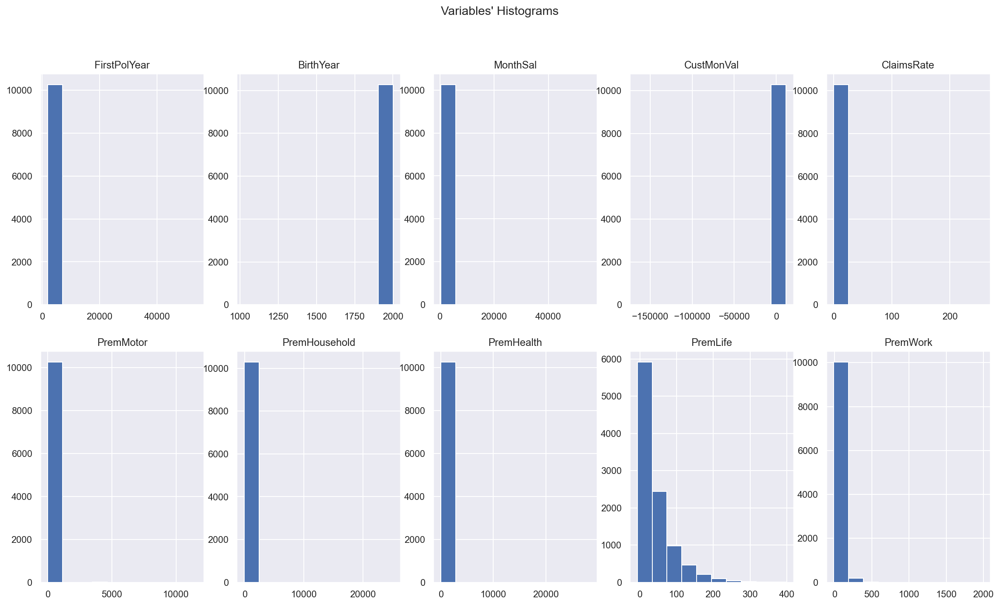

In [20]:
# All Numeric Variables' Histograms in one figure
sns.set()

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each histogram:
for ax, feat in zip(axes.flatten(), metric_features): 
    ax.hist(df[feat])
    ax.set_title(feat, loc='center')
    
# Layout
# Add a centered title to the figure:
title = "Variables' Histograms"

plt.suptitle(title)

plt.show()

# The histograms let us see that we have outliers in most of our features

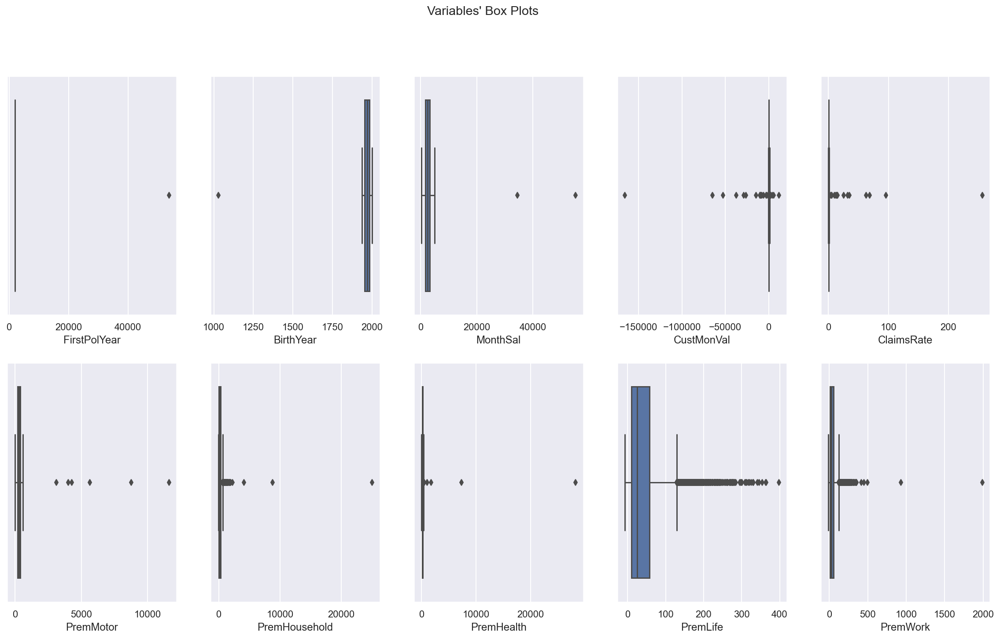

In [21]:
# All Numeric Variables' Box Plots in one figure
sns.set()

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=df[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Variables' Box Plots"

plt.suptitle(title)

plt.show()

# The boxplots confirm that we have outliers in most of our features

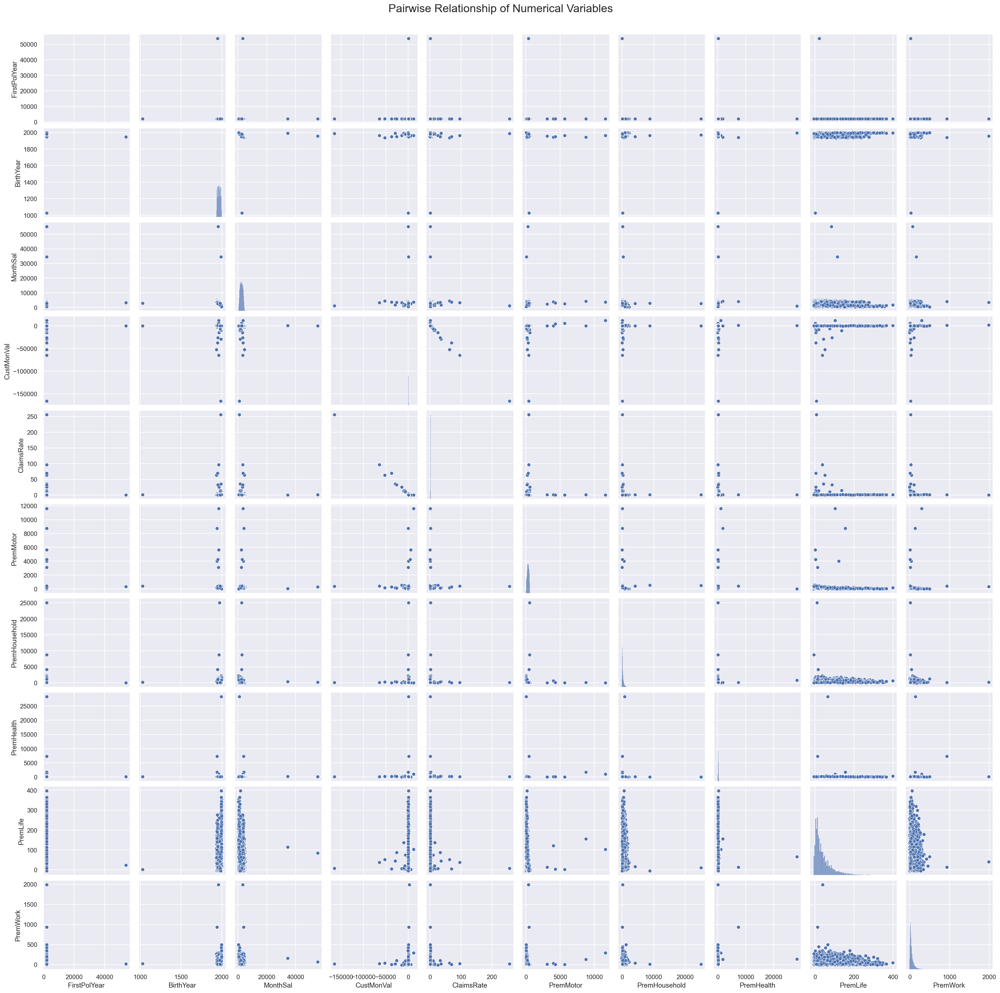

In [22]:
# Pairwise Relationship of Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(df[metric_features], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

# In the pairwise graph we can also identify outliers in most of our variables

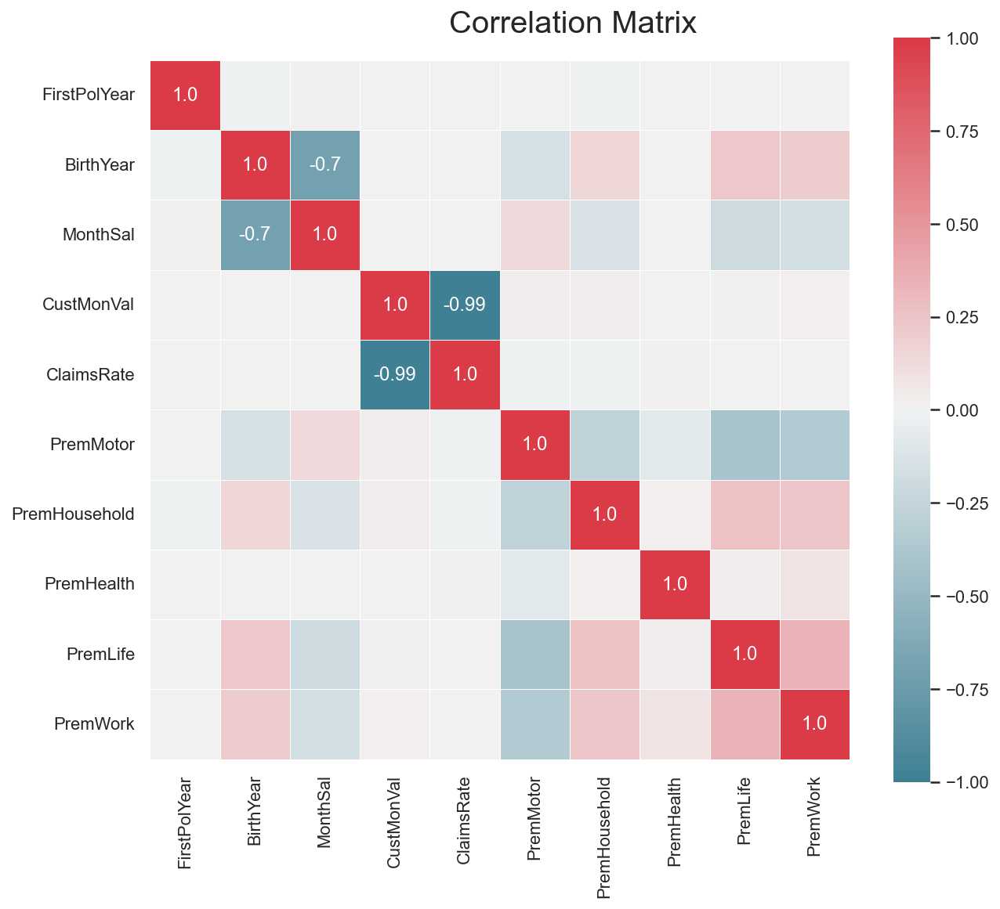

In [21]:
# Prepare figure
fig = plt.figure(figsize=(10, 8))

# Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
corr = np.round(df[metric_features].corr(method="pearson"), decimals=2)

# Build annotation matrix (values above |0.5| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) 

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

# Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()

# Prior pre processing, the following variables are highly correlated:
# BirthYear with MonthSal and CustMonVal with ClaimsRate
# It also seems that FirstPolYear is not correlated with any other variable
# So this variable might not be relevant for our analisys
# But we will have to check again after pre processing

### 1.2.2 Visual Exploration Categorical Features

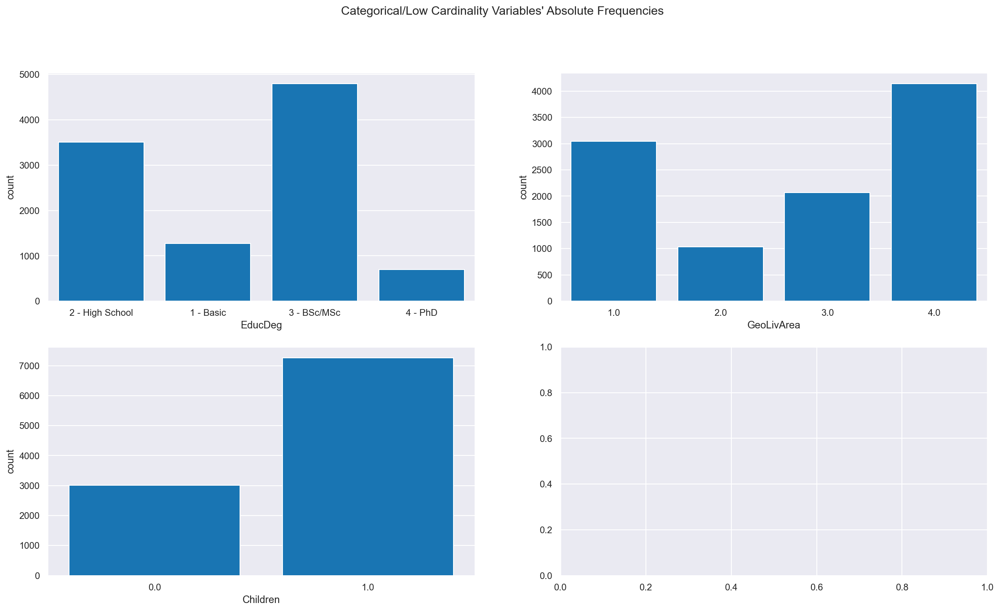

In [22]:
# All Non-Metric Variables' Absolute Frequencies
sns.set()

# Prepare figure. Create individual axes where each bar plot will be placed
fig, axes = plt.subplots(2, ceil(len(non_metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each bar plot:
for ax, feat in zip(axes.flatten(), non_metric_features): 
    sns.countplot(x=df[feat].astype(object), ax=ax, color='#007acc')

title = "Categorical/Low Cardinality Variables' Absolute Frequencies"
plt.suptitle(title)

plt.show()

# In the graphs we can see that most of costumers in the database hava a BSc/MSc or High Shool degree,
# Live in areas 1 and 4, and have children.
# We could say there are not low frequency values 
# and cardinality could be considered as low, with maximum 4 possible values for each attribute

### 1.2.3 Comparing a categorical variable vs continuous (or discrete) variables

#### 1.2.3.1 EducDeg

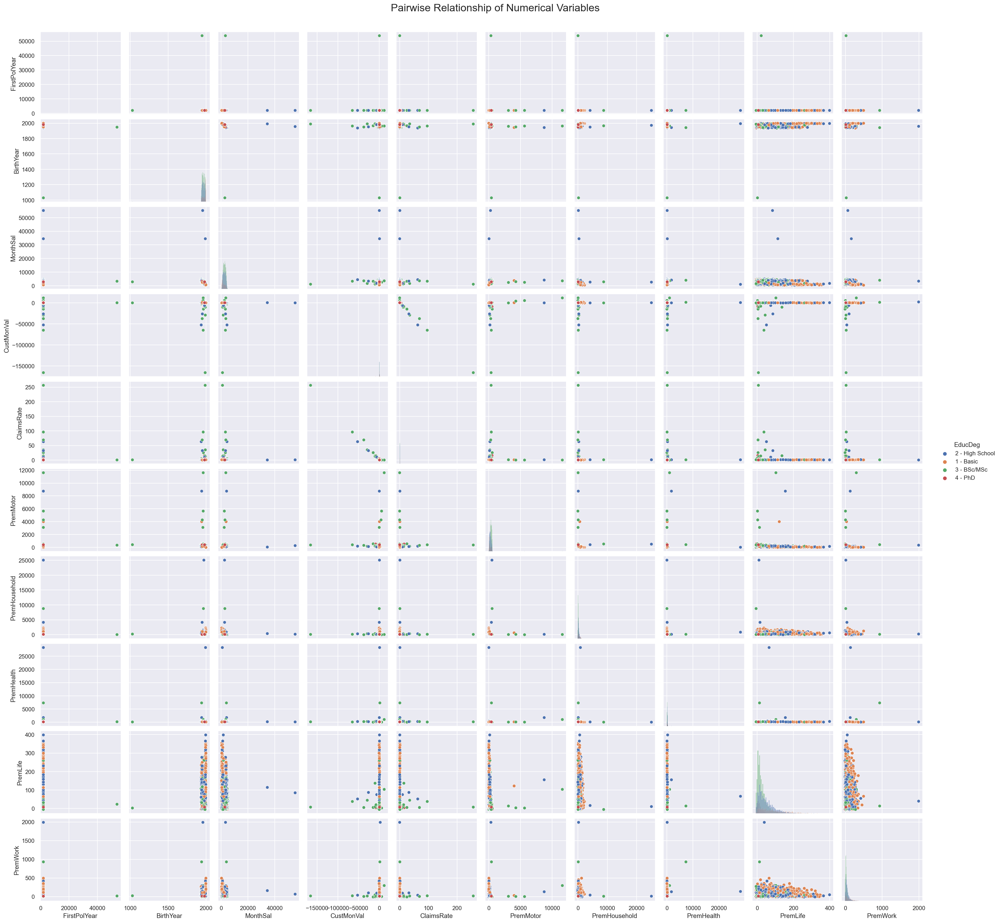

In [25]:
# Pairwise Relationship of Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(df[metric_features + ['EducDeg']], diag_kind="hist", hue='EducDeg')

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

# Prior pre processing it doesn't seem to be a clear relationship between Education Degree and any numeric variable

#### 1.2.3.2 GeoLivArea

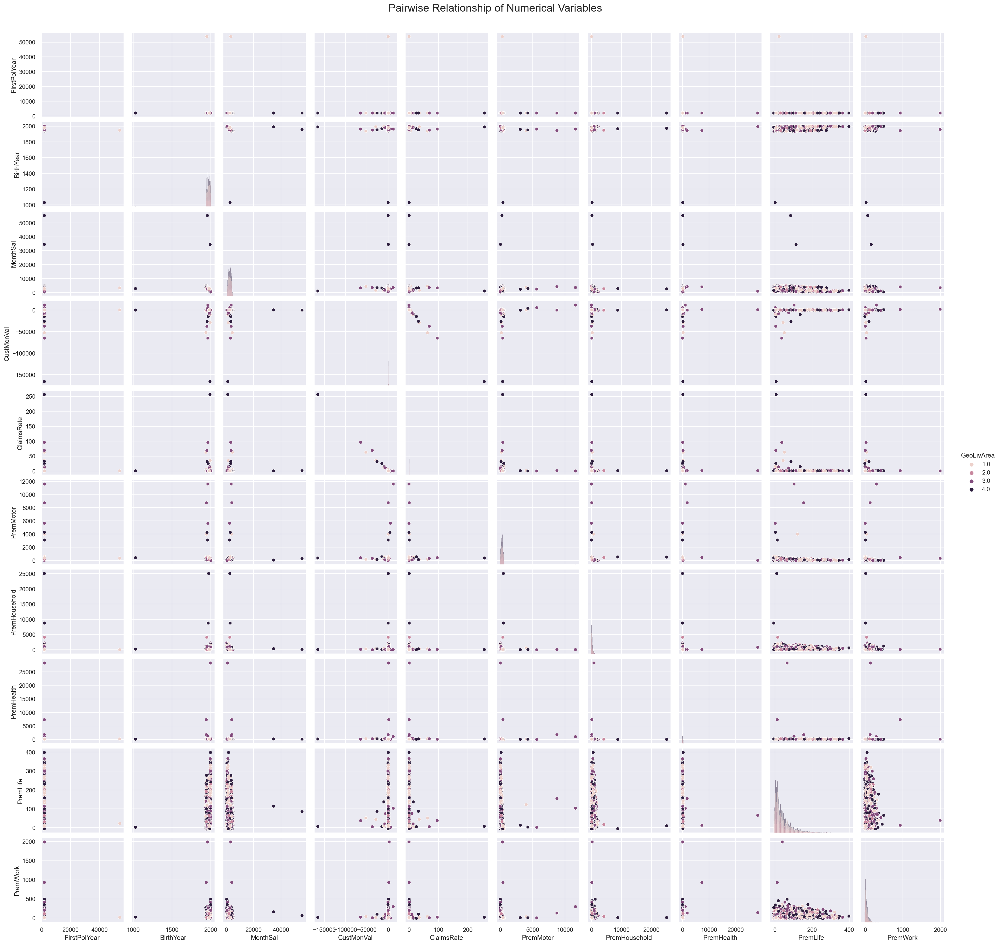

In [26]:
# Pairwise Relationship of Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(df[metric_features + ['GeoLivArea']], diag_kind="hist", hue='GeoLivArea')

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

# Prior pre processing it doesn't seem to be a clear relationship between Geographical Area and any numeric variable

#### 1.2.3.3 Children

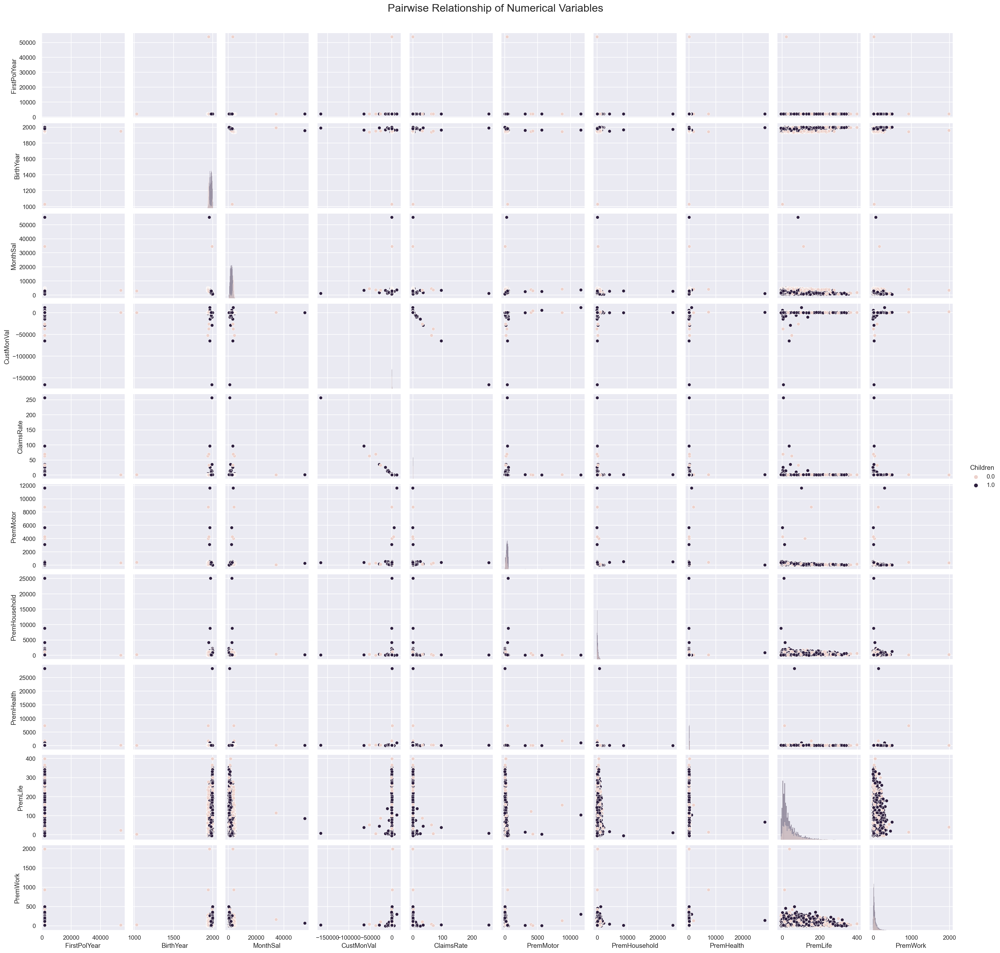

In [27]:
# Pairwise Relationship of Numerical Variables
sns.set()

# Setting pairplot
sns.pairplot(df[metric_features + ['Children']], diag_kind="hist", hue='Children')

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

# Prior pre processing it doesn't seem to be a clear relationship between Children and any numeric variable

## 1.3 pandas-profiling to assist with the exploratory data analysis

In [28]:
profile = ProfileReport(
    df, 
    title='A2Z Insurance Customer Data',
    correlations={
        "pearson": {"calculate": True},
        "spearman": {"calculate": False},
        "kendall": {"calculate": False},
        "phi_k": {"calculate": False},
        "cramers": {"calculate": False},
    },
)

In [29]:
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### With pandas profiling we can confirm that:

- We have 11 numeric and 3 categorical features in our Dataset
- The CustIDs are unique and can be used as our index
- FirstPolYear is skewed and has 30 missing values
- BirthYear has 17 missing values and is highly correlated with MonthSal
- EducDeg has 17 missing values
- MonthSal has 36 missing values and is highly correlated with BirthYear
- GeoLivArea has 1 missing value
- Children has 21 missing values
- CustMonVal is skewed and is highly correlated with ClaimsRate
- ClaimsRate is skewed and is highly correlated with CustMonVal
- PremMotor is skewed and has 34 missing values
- PremHousehold is skewed
- PremHealth is skewed and has 43 missing values
- PremLife has 104 missing values
- PremWork has 86 missing values

# 2. DATA PRE-PROCESSING

## 2.1 Elimintaing Duplicate Rows

In [23]:
#Eliminating the three duplicate rows found in the exploration
df.drop([8014,8122,9554], inplace=True)

## 2.2 Feature Engeneering

In [24]:
# Transfrorming BirthYear into Age as it increases readability
df['Age'] =(2016) - df['BirthYear']

# Transfrorming FirstPolYear into CustDur as it increases readability
df['CustDur'] =(2016) - df['FirstPolYear']

In [25]:
#Dropping columns which change due to feature engineering
df=df.drop(columns=["FirstPolYear"])
df=df.drop(columns=[ "BirthYear"])

In [26]:
#Checking the dataframe again
df.head()

,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,Age,CustDur
CustID,,,,,,,,,,,,,
1,2 - High School,2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89,34.0,31.0
2,2 - High School,677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13,21.0,35.0
3,1 - Basic,2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02,46.0,25.0
4,3 - BSc/MSc,1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34,35.0,26.0
5,3 - BSc/MSc,1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45,43.0,30.0


In [27]:
#Updating metric and non-metric features. 
non_metric_features = ["EducDeg", "GeoLivArea", "Children"]
metric_features = df.columns.drop(non_metric_features).to_list()

## 2.3 Coherence Check

### 2.3.1 Rule 1 - Age must be Positive 

In [28]:
# Checking if there are observations that don't satisfy this rule
rule1 = df[(df['Age'] < 0)]
rule1

# Al rows satisfy rule 1

,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,Age,CustDur
CustID,,,,,,,,,,,,,


### 2.3.2 Rule 2 - CustDur must be positive

In [29]:
# Checking if there are observations that don't satisfy this rule
rule2 = df[(df['CustDur']<0)]

# There is only one row that does not satisfy rule 2 (CustID = 9295)
# We will replace the value with NaN in order to later apply the Inputer
df.loc[df['CustDur'] < 0, 'CustDur'] = np.nan

### 2.3.3 Rule 3 - Age must be bigger than CustDur

In [30]:
# Checking if there are observations that don't satisfy this rule
rule3 = df[df['Age']<df['CustDur']]

# There are 1.997 records where rule 1 is not satisfied
# we will replace the CustDur with NaN in order to later apply the Inputer
df.loc[df['Age'] < df['CustDur'] , 'CustDur'] = np.nan

## 2.4 Filling Missing Values

In [31]:
#Checking null values
df.isna().sum()

EducDeg            17
MonthSal           36
GeoLivArea          1
Children           21
CustMonVal          0
ClaimsRate          0
PremMotor          34
PremHousehold       0
PremHealth         43
PremLife          104
PremWork           86
Age                17
CustDur          2028
dtype: int64

In [32]:
# Filling missing values in non metric features with the modes

modes = df[non_metric_features].mode().loc[0]
df.fillna(modes, inplace=True)

In [33]:
# Creating new df copy to explore KNN Imputer
df_KNN = df.copy()

In [34]:
# Initiate scaler and scale data
scaler = MinMaxScaler()
df_KNN_scaled = scaler.fit_transform(df_KNN[metric_features])

# Filling missing values in metric features with KNN imputer

imputer = KNNImputer(n_neighbors=5, weights="uniform")
df_KNN[metric_features] = imputer.fit_transform(df[metric_features])

In [35]:
#  Reversing data to original scale
scaler.inverse_transform(df_KNN[metric_features])

array([[ 1.19478447e+08,  6.74779470e+07,  9.99180000e+01, ...,
         3.37798230e+04,  3.30970000e+04,  7.62000000e+02],
       [ 3.71554470e+07, -2.34486394e+07,  2.86944000e+02, ...,
         2.12322291e+05,  2.04480000e+04,  4.88400000e+02],
       [ 1.24966647e+08,  8.94416625e+07,  7.17360000e+01, ...,
         1.98097314e+05,  4.47730000e+04,  6.18000000e+02],
       ...,
       [ 1.60146009e+08,  9.28915817e+07,  5.38020000e+01, ...,
         9.77142300e+03,  3.89350000e+04,  5.46000000e+02],
       [ 1.08172755e+08,  4.42322749e+07,  1.66530000e+02, ...,
         2.25887037e+05,  3.79620000e+04,  8.58000000e+02],
       [ 1.54493163e+08,  8.21760583e+07,  6.91740000e+01, ...,
         2.57770230e+04,  3.40700000e+04,  6.42000000e+02]])

#### let's keep the KNN imputed data

In [36]:
df = df_KNN.copy()
df.head()

,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,Age,CustDur
CustID,,,,,,,,,,,,,
1,2 - High School,2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89,34.0,31.0
2,2 - High School,677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13,21.0,19.6
3,1 - Basic,2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02,46.0,25.0
4,3 - BSc/MSc,1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34,35.0,26.0
5,3 - BSc/MSc,1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45,43.0,30.0


In [37]:
#Checking null values again
df.isna().sum()

EducDeg          0
MonthSal         0
GeoLivArea       0
Children         0
CustMonVal       0
ClaimsRate       0
PremMotor        0
PremHousehold    0
PremHealth       0
PremLife         0
PremWork         0
Age              0
CustDur          0
dtype: int64

## 2.5 Outlier Removal

#### Reference: https://towardsdatascience.com/detecting-outliers-with-simple-and-advanced-techniques-cb3b2db60d03

### 2.5.1 Univariate Outliers

#### 2.5.1.1 Standard Deviation Method

In [38]:
# Creating new df copy to explore std outlier removal
df_std = df.copy()

In [39]:
for metric in metric_features:
    # Find mean, standard deviation and cut off value 
    mean = df_std[metric].mean()
    std = df_std[metric].std()
    cutoff = 3 * std

    # Define lower and upper boundaries
    lower, upper = mean-cutoff, mean+cutoff

    # Define new dataset by masking upper and lower boundaries
    df_std = df_std[(df_std[metric] > lower) & (df_std[metric] < upper)]
    
print('Percentage of data kept after removing outliers:', np.round(df_std.shape[0] / df.shape[0], 4))

# With this method we lose too much data hence we will not use it

Percentage of data kept after removing outliers: 0.9575


#### 2.5.1.2 Inter-Quartile Range Method

In [40]:
# Creating new df copy to explore IQR outlier removal
df_IQR = df.copy()

In [41]:
for metric in metric_features:
    # Find Q1, Q3, IQR and cut off value 
    q25, q75 = np.quantile(df_IQR[metric], 0.25), np.quantile(df_IQR[metric], 0.75)
    iqr = q75 - q25
    cutoff = 1.5 * iqr

    # Define lower and upper boundaries
    lower, upper = q25 - cutoff, q75 + cutoff

    # Define new dataset by masking upper and lower boundaries
    df_IQR = df_IQR[(df_IQR[metric] > lower) & (df_IQR[metric] < upper)]

print('Percentage of data kept after removing outliers:', np.round(df_IQR.shape[0] / df.shape[0], 4))

# With this method we lose too much data hence we will not use it

Percentage of data kept after removing outliers: 0.8214


#### 2.5.1.3 Manual Outlier Filtering Method

In [42]:
# Creating new df copy to explore manual filtering outlier removal
df_manual_filtering = df.copy()

In [43]:
"""
Due to the fact that Standard Deviation and IQR filtering led to the removal of an excessive amount of data,
for 8 features the following filter values were applied:
df['MonthSal']>50000
df['CustMonVal']>3000 and <-2000
df['PremHousehold']>2400
df['PremWork']>425
df['PremMotor']>3000
df['PremHealth']>600
df['Age']>115 and <0
df['CustomerDuration']<0

"""

df_manual_filtering = df_manual_filtering[ (df_manual_filtering['CustMonVal']<3000) &
          (df_manual_filtering['PremHousehold']<2400) &
          (df_manual_filtering['PremWork']<425) &
          (df_manual_filtering['MonthSal']<50000) &
          (df_manual_filtering['CustMonVal']<3000) &
          (df_manual_filtering['CustMonVal']>-2000) &
          (df_manual_filtering['PremHousehold']<2400) &
          (df_manual_filtering['PremWork']<425) &
          (df_manual_filtering['PremMotor']<3000) &
          (df_manual_filtering['PremHealth']<600) & 
          (df_manual_filtering['Age'].isna() | (df_manual_filtering['Age']<115))]
    

print('Percentage of data kept after removing outliers:', np.round(df_manual_filtering.shape[0] / df.shape[0], 4))

Percentage of data kept after removing outliers: 0.9971


### 2.5.2 Multivariate Outlier Detection

####  2.5.2.1 Isolation Forest Method

In [44]:
# Creating new df copy to explore isolation forest outlier removal
df_IF = df.copy()

In [45]:
# Initiate isolation forest
isolation = IsolationForest(n_estimators=100, 
                            contamination='auto', 
                            max_features=df_IF[metric_features].shape[1],
                            random_state=42)

# Fit and predict
isolation.fit(df_IF[metric_features])
outliers_predicted = isolation.predict(df_IF[metric_features])

# Address outliers in a new column
df_IF['outlier'] = outliers_predicted


print('Percentage of data kept after removing outliers:', np.round(df_IF['outlier'].value_counts()[1] / df.shape[0], 4))

# With this method we lose too much data hence we will not use it

Percentage of data kept after removing outliers: 0.868


#### 2.5.2.2 Density-Based Spatial Clustering of Applications with Noise (DBSCAN) Method

In [46]:
# Creating new df copy to explore DBSCAN outlier removal
df_DBSCAN = df.copy()

In [47]:
# Initiate scaler and scale data
scaler = MinMaxScaler()
df_DBSCAN_scaled = scaler.fit_transform(df_DBSCAN[metric_features])

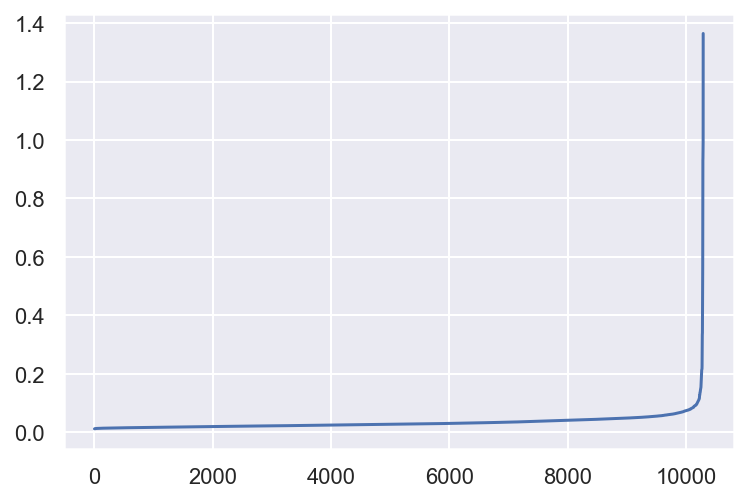

In [48]:
# K-distance graph to find out the right eps value
neigh = NearestNeighbors(n_neighbors=20)
neigh.fit(df_DBSCAN_scaled)
distances, _ = neigh.kneighbors(df_DBSCAN_scaled)
distances = np.sort(distances[:, -1])
plt.plot(distances)
plt.show()

In [49]:
# Initiate DBSCAN
dbscan = DBSCAN(eps=0.1, min_samples=20) # rule of thumb, minPts = 2 x dim

# Fit DBSCAN on scaled data
dbscan.fit(df_DBSCAN_scaled)

# Address outliers in a new column
df_DBSCAN['outlier'] = dbscan.labels_

print('Percentage of data kept after removing outliers:', np.round(df_DBSCAN['outlier'].value_counts()[0] / df.shape[0], 4))

Percentage of data kept after removing outliers: 0.9954


#### 2.5.2.3 Local Outlier Factor (LOF)

In [50]:
# Creating new df copy to explore LOF outlier removal
df_LOF = df.copy()

In [51]:
# Initiate LOF
lof = LocalOutlierFactor(n_neighbors=20, contamination='auto')

# Initiate scaler and scale data
scaler = MinMaxScaler()
df_LOF_scaled = scaler.fit_transform(df_LOF[metric_features])

# Fit and predict on scaled data
outliers_predicted = lof.fit_predict(df_LOF_scaled)

# Address outliers in a new column
df_LOF['outlier'] = outliers_predicted

print('Percentage of data kept after removing outliers:', np.round(df_LOF['outlier'].value_counts()[1] / df.shape[0], 4))

Percentage of data kept after removing outliers: 0.9875


### 2.5.3 Combining Outlier Methods (Manual Filter + DBSCAN + LOF)

We will combine the three outlier removal methods where we lost the least amount of data

In [52]:
# Creating new df copy to explore combined outlier removal
df_com = df_manual_filtering.copy()

In [53]:
# Initiate scaler and scale data
scaler = MinMaxScaler()
df_com_scaled = scaler.fit_transform(df_com[metric_features])

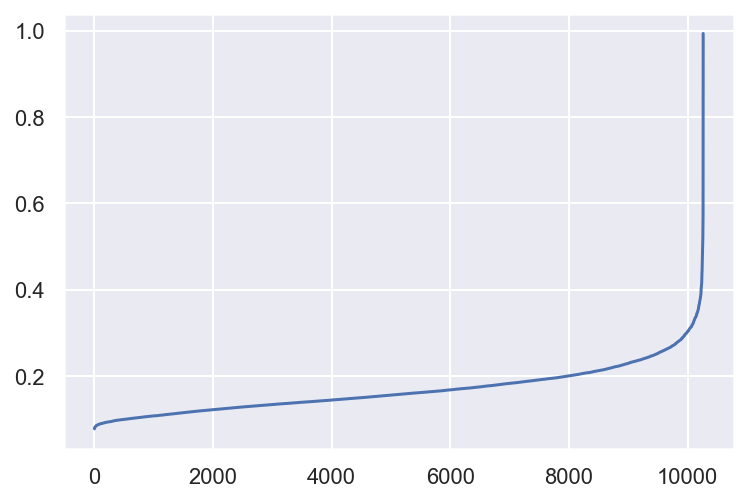

In [54]:
# K-distance graph to find out the right eps value
neigh = NearestNeighbors(n_neighbors=20)
neigh.fit(df_com_scaled)
distances, _ = neigh.kneighbors(df_com_scaled)
distances = np.sort(distances[:, -1])
plt.plot(distances)
plt.show()

In [55]:
# Initiate DBSCAN
dbscan = DBSCAN(eps=0.3, min_samples=20) # rule of thumb, minPts = 2 x dim

# Fit DBSCAN on scaled data
dbscan.fit(df_com_scaled)

# Address outliers in a new column
df_com['outlier'] = dbscan.labels_

print('Percentage of data kept after removing outliers:', np.round(df_com['outlier'].value_counts()[0] / df.shape[0], 4))

Percentage of data kept after removing outliers: 0.9938


In [56]:
df_com_2 = df_com[df_com['outlier'] == 0]

In [57]:
df_com_3 = df_com_2.drop(columns=["outlier"])

In [58]:
# Initiate LOF
lof = LocalOutlierFactor(n_neighbors=20, contamination='auto')

# Fit and predict on scaled data
outliers_predicted = lof.fit_predict(df_com_3[metric_features])

# Address outliers in a new column
df_com_3['outlier'] = outliers_predicted

print('Percentage of data kept after removing outliers:', np.round(df_com_3['outlier'].value_counts()[1] / df.shape[0], 4))

Percentage of data kept after removing outliers: 0.9884


#### Saving the newly detected outliers (they will be classified later based on the final clusters)

In [59]:
df_out = df_com_3.loc[df_com_3['outlier'] == -1].copy()

In [60]:
df_out.head()

,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,Age,CustDur,outlier
CustID,,,,,,,,,,,,,,
146,1 - Basic,2554.0,1.0,1.0,-96.11,1.12,144.36,-11.10,381.85,47.23,12.78,30.0,34.2,-1
282,3 - BSc/MSc,3083.0,1.0,1.0,-175.00,1.30,506.43,-75.00,55.90,5.89,1.78,54.0,39.0,-1
288,2 - High School,2193.0,3.0,1.0,618.80,0.00,139.58,82.25,246.49,72.57,102.91,41.0,28.0,-1
502,2 - High School,2483.0,1.0,1.0,625.68,0.00,160.03,73.35,129.69,116.91,170.70,48.0,38.0,-1
575,1 - Basic,3110.0,4.0,1.0,-233.26,1.26,116.02,255.60,163.81,60.79,208.26,59.0,29.0,-1


#### let's keep the combined outlier removal

In [61]:
df = df_com_3.drop(columns=["outlier"]).copy()
df.head()

,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,Age,CustDur
CustID,,,,,,,,,,,,,
1,2 - High School,2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89,34.0,31.0
2,2 - High School,677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13,21.0,19.6
3,1 - Basic,2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02,46.0,25.0
4,3 - BSc/MSc,1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34,35.0,26.0
5,3 - BSc/MSc,1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45,43.0,30.0


In [62]:
#Making a copy of this dataset as we will use it later in the cluster visualizations
df_preprocessed = df.copy()
df_preprocessed.head()

,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,Age,CustDur
CustID,,,,,,,,,,,,,
1,2 - High School,2177.0,1.0,1.0,380.97,0.39,375.85,79.45,146.36,47.01,16.89,34.0,31.0
2,2 - High School,677.0,4.0,1.0,-131.13,1.12,77.46,416.20,116.69,194.48,106.13,21.0,19.6
3,1 - Basic,2277.0,3.0,0.0,504.67,0.28,206.15,224.50,124.58,86.35,99.02,46.0,25.0
4,3 - BSc/MSc,1099.0,4.0,1.0,-16.99,0.99,182.48,43.35,311.17,35.34,28.34,35.0,26.0
5,3 - BSc/MSc,1763.0,4.0,1.0,35.23,0.90,338.62,47.80,182.59,18.78,41.45,43.0,30.0


### 2.5.4 Visual Exploration after Outlier Removal

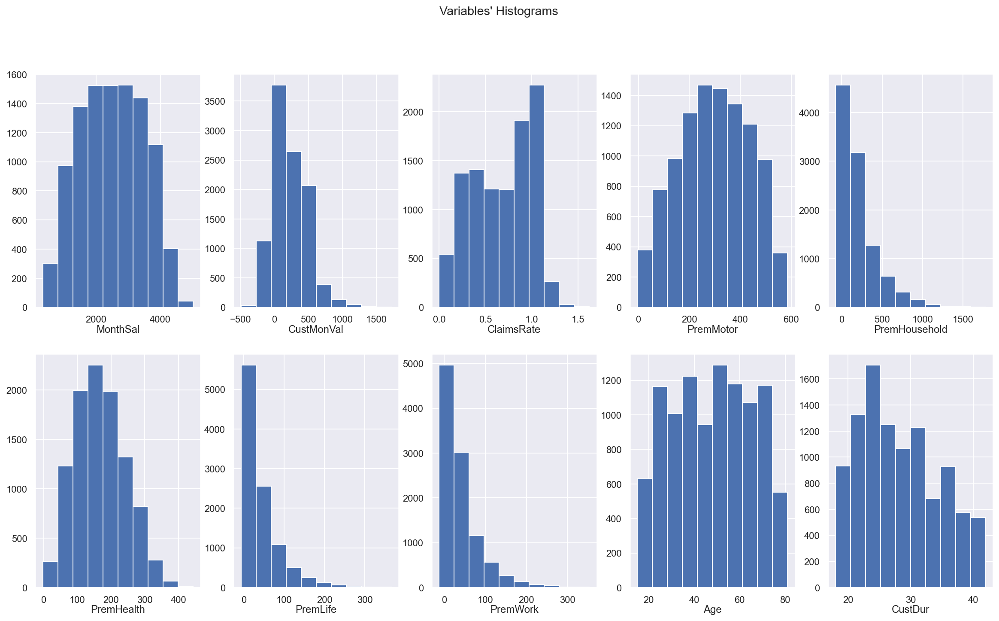

In [63]:
# All Numeric Variables' Histograms in one figure
sns.set()

# Prepare figure. Create individual axes where each histogram will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each histogram:
for ax, feat in zip(axes.flatten(), metric_features): 
    ax.hist(df[feat])
    ax.set_title(feat, y=-0.13)
    
# Layout
# Add a centered title to the figure:
title = "Variables' Histograms"

plt.suptitle(title)

plt.show()

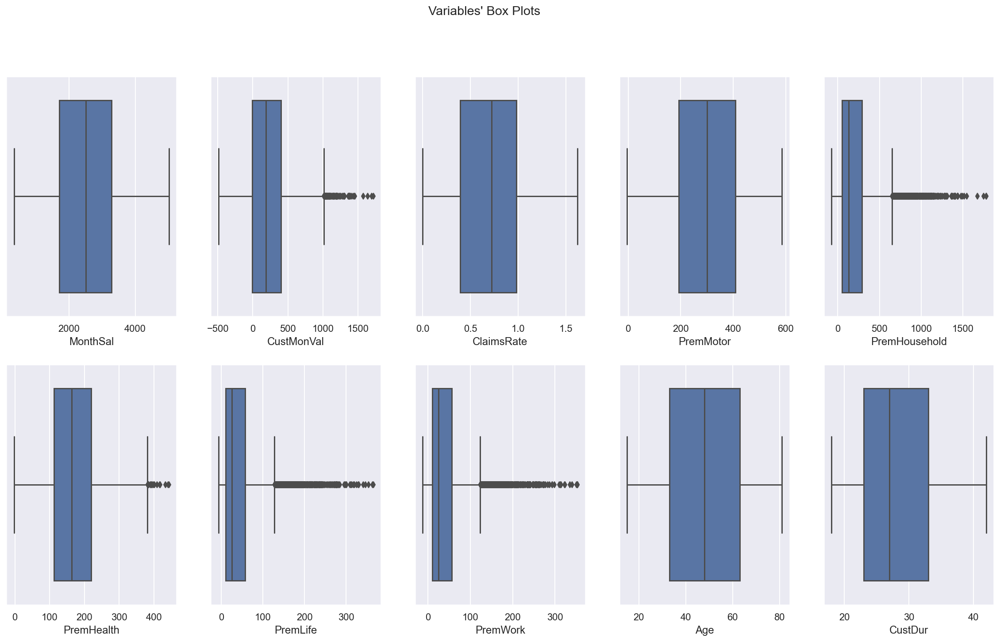

In [71]:
# All Numeric Variables' Box Plots in one figure
sns.set()

# Prepare figure. Create individual axes where each box plot will be placed
fig, axes = plt.subplots(2, ceil(len(metric_features) / 2), figsize=(20, 11))

# Plot data
# Iterate across axes objects and associate each box plot (hint: use the ax argument):
for ax, feat in zip(axes.flatten(), metric_features): # Notice the zip() function and flatten() method
    sns.boxplot(x=df[feat], ax=ax)
    
# Layout
# Add a centered title to the figure:
title = "Variables' Box Plots"

plt.suptitle(title)

plt.show()

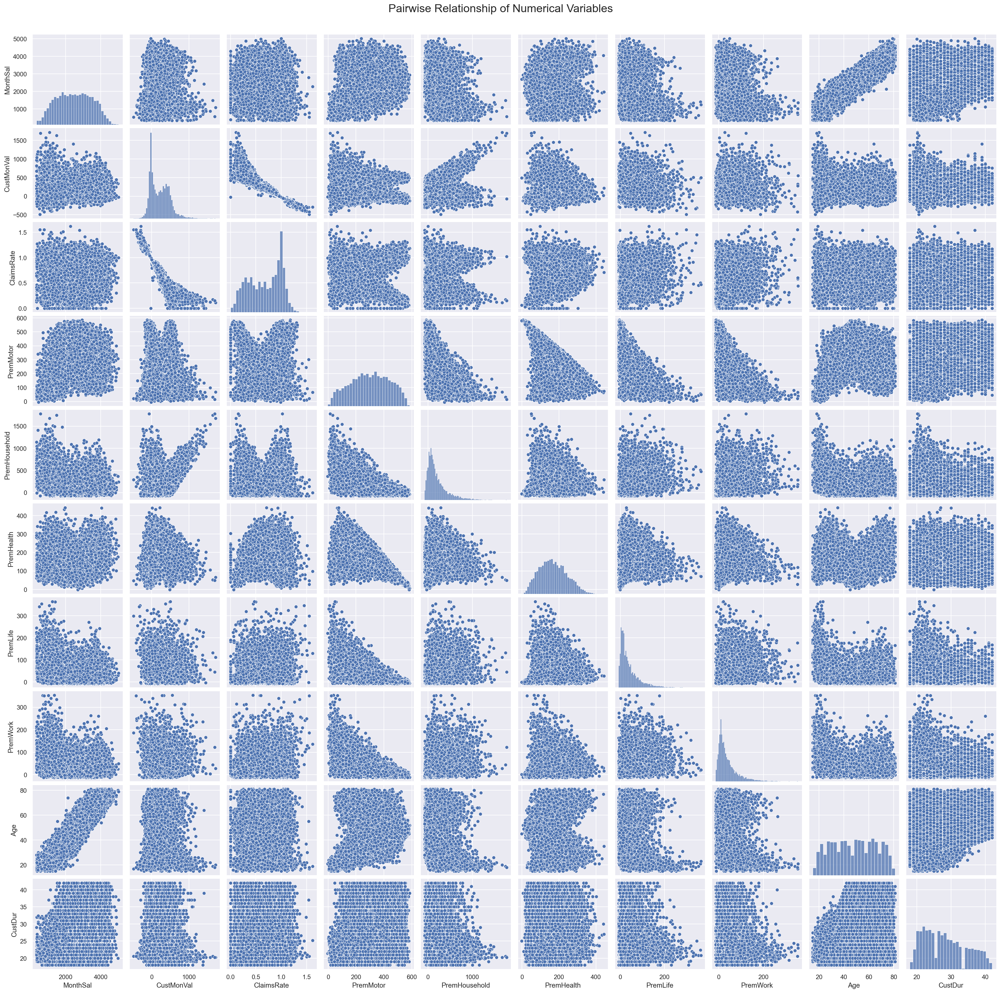

In [72]:
# Pairwise Relationship of Numerical Variables after outlier removal
sns.set()

# Setting pairplot
sns.pairplot(df[metric_features], diag_kind="hist")

# Layout
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)

plt.show()

## 2.6 Feature Selection (Redundancy and Relevancy)

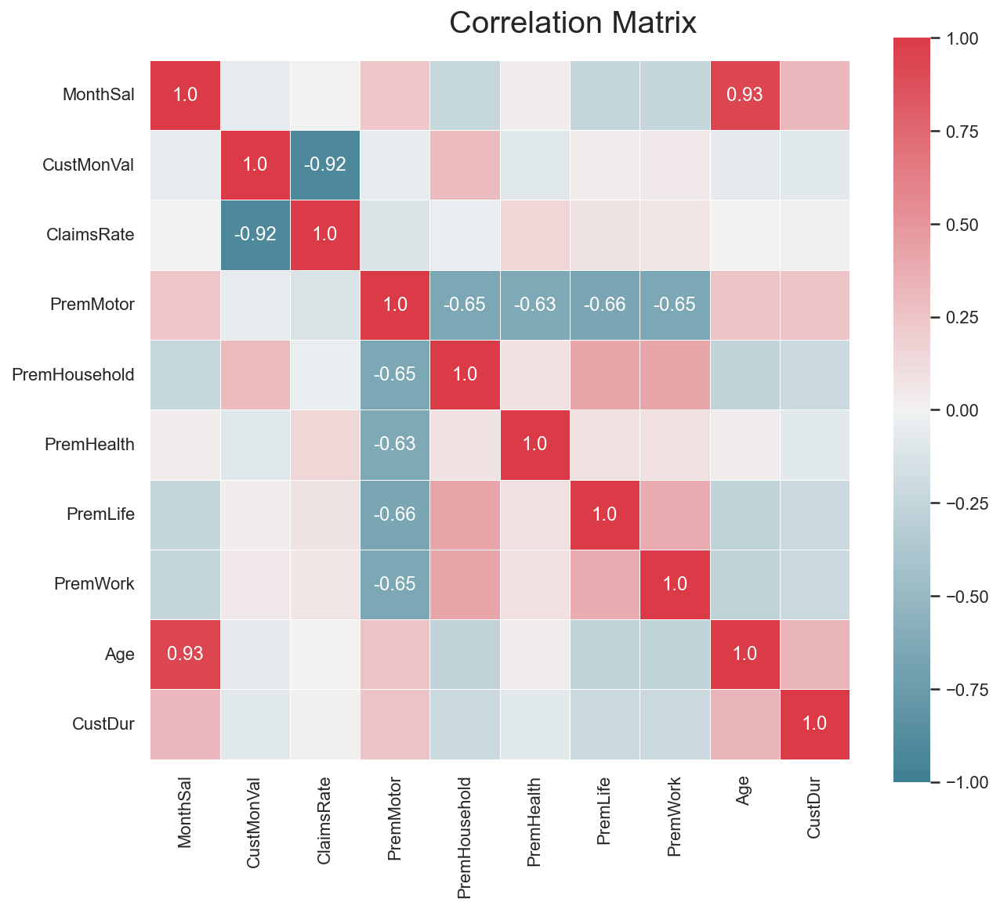

In [64]:
# Correlation Matrix after pre processing

# Prepare figure
fig = plt.figure(figsize=(10, 8))

# Obtain correlation matrix. Round the values to 2 decimal cases. Use the DataFrame corr() and round() method.
corr = np.round(df[metric_features].corr(method="pearson"), decimals=2)

# Build annotation matrix (values above |0.5| will appear annotated in the plot)
mask_annot = np.absolute(corr.values) >= 0.5
annot = np.where(mask_annot, corr.values, np.full(corr.shape,"")) 

# Plot heatmap of the correlation matrix
sns.heatmap(data=corr, annot=annot, cmap=sns.diverging_palette(220, 10, as_cmap=True), 
            fmt='s', vmin=-1, vmax=1, center=0, square=True, linewidths=.5)

# Layout
fig.subplots_adjust(top=0.95)
fig.suptitle("Correlation Matrix", fontsize=20)

plt.show()


# Also all the other premiums are correlated with the MotorPremium

### 2.6.1 Redundancy

Post pre processing, the following variables are highly correlated:
- CustMonVal with ClaimsRate (negative correlation): this makes sense since the more claims the client makes, the less profitable it is for the company and its CustMonVal deteriorates. We will keep the CustMonVal for the analysis as we believe is a more comprenhensive feature.
- Age with MonthSal (positive correlation): This makes sense since usually the older a person is, the more experience they have and the higher their salary can be. We will keep MonthSal for the analysis as we believe purchasing power is a very important feature for the inssurance business, regardless the age of the customer.

*Note: after running different clustering exercices with different combinations of feature selection and numer of clusters, and analysing their visualizations and basic profiling, we conffirmed this was the best feature selection opction. We will explain more about this on the report.

In [65]:
# Dropping ClaimsRate and MonthSal for the clustering analysis
df = df.drop(columns=['ClaimsRate','Age']).copy()

### 2.6.2 Relevancy

After pre processing we did not find any irrelevant variables, they where all correlated in some level with others. Therefore we will not eliminate any variable via relevancy.

In [66]:
#Updating metric and non-metric features. 
non_metric_features = ["EducDeg", "GeoLivArea", "Children"]
metric_features = df.columns.drop(non_metric_features).to_list()

## 2.7 Scaling Final Dataset for Clustering

In [67]:
#Scaling the metric features 
scaler = MinMaxScaler()
df_scaled = scaler.fit_transform(df[metric_features])
df_scaled = pd.DataFrame(df_scaled, columns = df[metric_features].columns).set_index(df.index)
df_scaled

,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,CustDur
CustID,,,,,,,,
1,0.393345,0.394874,0.644732,0.083372,0.333663,0.145118,0.079112,0.541667
2,0.073379,0.162755,0.138411,0.265148,0.266984,0.541351,0.323484,0.066667
3,0.414676,0.450943,0.356778,0.161669,0.284716,0.250819,0.304014,0.291667
4,0.163396,0.214491,0.316614,0.063885,0.704047,0.113762,0.110466,0.333333
5,0.305034,0.238161,0.581559,0.066287,0.415084,0.069268,0.146366,0.500000
...,...,...,...,...,...,...,...,...
10292,0.609002,0.222142,0.675089,0.067178,0.395352,0.045086,0.073334,0.583333
10293,0.447526,0.859306,0.233638,0.599579,0.326674,0.053442,0.320746,0.875000
10294,0.551408,0.459750,0.691870,0.112170,0.324426,0.052851,0.046251,0.166667


# 3. CLUSTERING

For our clustering we defined two perspectives:
- Value Perspective: this includes the purchase power of the customer as well as their value for the company and wether they are recent or older cliets.
- Needs Perspective: this tells us what kind of inssurance need or needs does the customer have (motor, household, health, live and/or work)

## 3.1 Defining Perspectives

In [68]:
# Split variables into perspectives 
value_features = [
    'MonthSal',
    'CustDur',
    'CustMonVal'
]

needs_features = [
    'PremMotor', 
    'PremHousehold', 
    'PremHealth',
    'PremLife', 
    'PremWork', 
]

df_value = df_scaled[value_features].copy()
df_needs = df_scaled[needs_features].copy()

## 3.2 Auxiliary Functions for Clustering

In [69]:
def get_ss(df):
    """Computes the sum of squares for all variables given a dataset
    """
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

def r2(df, labels):
    sst = get_ss(df)
    ssw = np.sum(df.groupby(labels).apply(get_ss))
    return 1 - ssw/sst
    
def get_r2_scores(df, clusterer, min_k=2, max_k=10):
    """
    Loop over different values of k. To be used with sklearn clusterers.
    """
    r2_clust = {}
    for n in range(min_k, max_k):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        r2_clust[n] = r2(df, labels)
    return r2_clust

def get_r2_scores_gmm(df, clusterer, min_k=2, max_k=10):
    """
    Loop over different values of k. To be used with sklearn GaussianMixture
    """
    r2_clust = {}
    for n in range(min_k, max_k):
        clust = clone(clusterer).set_params(n_components=n)
        labels = clust.fit_predict(df)
        r2_clust[n] = r2(df, labels)
    return r2_clust

## 3.3 Finding the optimal clusterer

In [70]:
# Setting up the clusterers

kmeans = KMeans(
    init='k-means++',
    n_init=20,
    random_state=42
)

hierarchical = AgglomerativeClustering(
    affinity='euclidean'
)

gmm = GaussianMixture(
    covariance_type='full', 
    n_init=10, 
    init_params='kmeans', 
    random_state=42
)

### 3.3.1 Finding the optimal clusterer on value variables

In [71]:
# Obtaining the R² scores for each cluster solution (K-means and Hierarchical) on value variables
r2_scores = {}

r2_scores['kmeans'] = get_r2_scores(df_value, kmeans)

for linkage in ['complete', 'average', 'ward']:
    r2_scores[linkage] = get_r2_scores(
        df_value, hierarchical.set_params(linkage=linkage) 
    )
    
pd.DataFrame(r2_scores)

,kmeans,complete,average,ward
2,0.440950,0.312341,0.001511,0.390436
3,0.611365,0.558569,0.398872,0.562984
4,0.680753,0.579909,0.399631,0.655965
5,0.722150,0.652760,0.565007,0.684339
6,0.750437,0.654932,0.565134,0.712341
7,0.775211,0.683604,0.565480,0.739177
8,0.793674,0.691546,0.567323,0.757830
9,0.807353,0.702018,0.664562,0.775660


In [72]:
# Obtaining the R² scores for cluster solution (GaussianMixture) on value variables
r2_scores_gmm = {}

r2_scores_gmm['gmm'] = get_r2_scores_gmm(df_value, gmm)

pd.DataFrame(r2_scores_gmm)

,gmm
2,0.432577
3,0.608090
4,0.670477
5,0.701198
6,0.706428
7,0.588168
8,0.782836
9,0.658161


In [73]:
# Merging R2 scores for visualization
r2_scores_final = pd.DataFrame(r2_scores_gmm).join(pd.DataFrame(r2_scores))

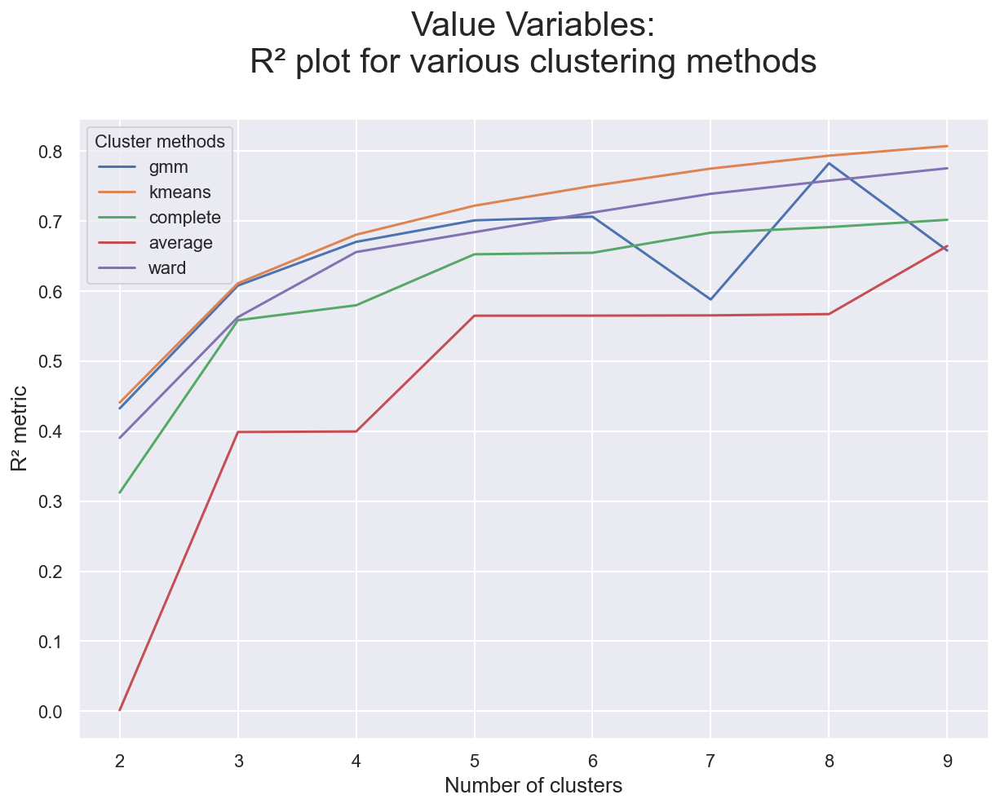

In [74]:
# Visualizing the R² scores for each cluster solution on value variables
r2_scores_final.plot.line(figsize=(10,7))

plt.title("Value Variables:\nR² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.show()

### 3.1.2 Finding the optimal clusterer on Needs variables

In [75]:
# Obtaining the R² scores for each cluster solution (K-means and Hierarchical) on Needs variables
r2_scores = {}

r2_scores['kmeans'] = get_r2_scores(df_needs, kmeans)

for linkage in ['complete', 'average', 'ward']:
    r2_scores[linkage] = get_r2_scores(
        df_needs, hierarchical.set_params(linkage=linkage) 
    )
    
pd.DataFrame(r2_scores)

,kmeans,complete,average,ward
2,0.471300,0.441038,0.247311,0.438344
3,0.613453,0.496639,0.253293,0.574345
4,0.687265,0.505662,0.261132,0.634950
5,0.717232,0.599997,0.261774,0.673294
6,0.745442,0.611734,0.503592,0.707543
7,0.771083,0.663330,0.524584,0.730489
8,0.789323,0.677055,0.537478,0.750401
9,0.802115,0.689670,0.537586,0.766205


In [76]:
# Obtaining the R² scores for cluster solution (GaussianMixture) on Needs variables
r2_scores_gmm = {}

r2_scores_gmm['gmm'] = get_r2_scores_gmm(df_needs, gmm)

pd.DataFrame(r2_scores_gmm)

,gmm
2,0.351949
3,0.512917
4,0.574049
5,0.606711
6,0.645920
7,0.659926
8,0.665026
9,0.686208


In [77]:
# Merging R2 scores for visualization
r2_scores_final = pd.DataFrame(r2_scores_gmm).join(pd.DataFrame(r2_scores))

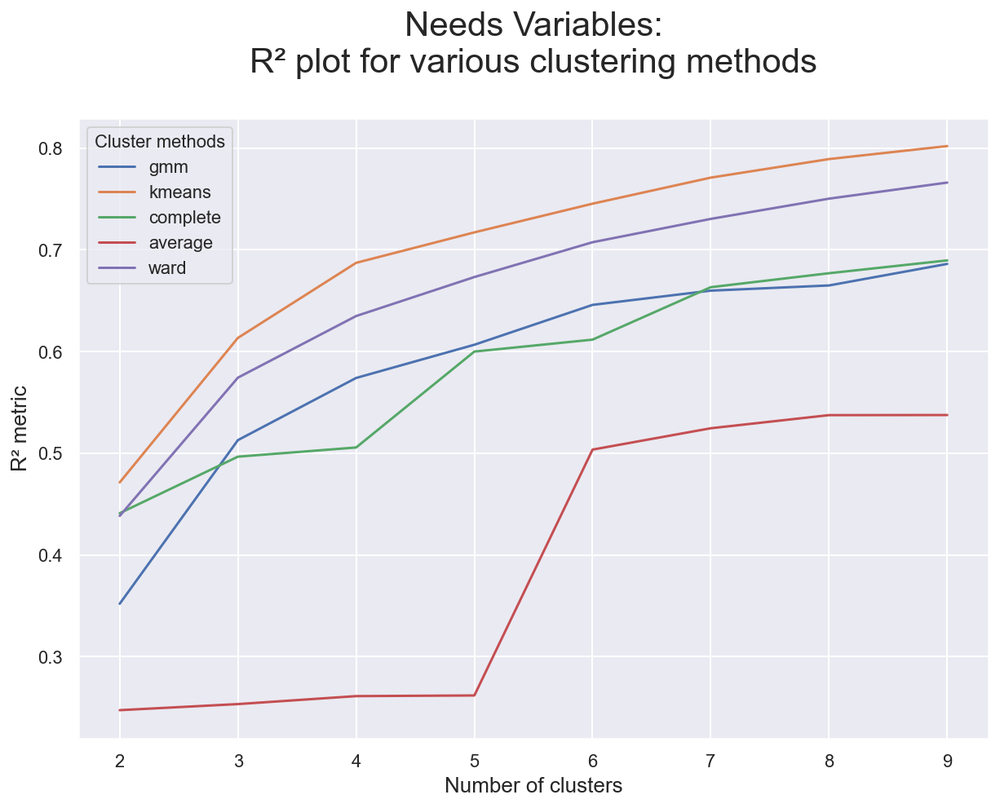

In [78]:
# Visualizing the R² scores for each cluster solution on demographic-value variables
r2_scores_final.plot.line(figsize=(10,7))

plt.title("Needs Variables:\nR² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.show()

## 3.2 Merging the Perspectives

In [79]:
# Applying the right clustering (algorithm and number of clusters) for each perspective
kmeans_value = KMeans(
    n_clusters=3,
    init='k-means++',
    n_init=20,
    random_state=42
)
value_labels = kmeans_value.fit_predict(df_value)

kmeans_needs = KMeans(
    n_clusters=3,
    init='k-means++',
    n_init=20,
    random_state=42
)
needs_labels = kmeans_needs.fit_predict(df_needs)

df_scaled['value_labels'] = value_labels
df_scaled['needs_labels'] = needs_labels

In [80]:
# Count label frequencies (contigency table)
df_scaled.groupby(['value_labels', 'needs_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('value_labels', 'needs_labels', 0)

needs_labels,0,1,2
value_labels,,,
0,1606,1085,1287
1,1223,1167,278
2,1437,1880,266


## 3.3 Reducing number of clusters

### 3.3.1 Manual merging: Merge lowest frequency clusters into closest clusters

Whit this solution we would get 7 clusters

In [81]:
# Clusters with low frequency to be merged:
to_merge = [(1,2), (2,2)]

df_centroids = df_scaled.groupby(['value_labels', 'needs_labels'])\
    [metric_features].mean()

# Computing the euclidean distance matrix between the centroids
euclidean = pairwise_distances(df_centroids)
df_dists = pd.DataFrame(
    euclidean, columns=df_centroids.index, index=df_centroids.index
)

# Merging each low frequency clustering (source) to the closest cluster (target)
source_target = {}
for clus in to_merge:
    if clus not in source_target.values():
        source_target[clus] = df_dists.loc[clus].sort_values().index[1]

source_target

{(1, 2): (1, 0), (2, 2): (2, 0)}

In [82]:
df_ = df_scaled.copy()

# Changing the dem_val_labels and needs_labels based on source_target
for source, target in source_target.items():
    mask = (df_['value_labels']==source[0]) & (df_['needs_labels']==source[1])
    df_.loc[mask, 'value_labels'] = target[0]
    df_.loc[mask, 'needs_labels'] = target[1]

# New contigency table
df_.groupby(['needs_labels', 'value_labels'])\
    .size()\
    .to_frame()\
    .reset_index()\
    .pivot('value_labels', 'needs_labels', 0)

needs_labels,0,1,2
value_labels,,,
0,1606.0,1085.0,1287.0
1,1501.0,1167.0,NaN
2,1703.0,1880.0,NaN


### 3.3.2 Merging using Hierarchical clustering

With this soluction we get 5 clusters

In [83]:
# Centroids of the concatenated cluster labels
df_centroids = df_scaled.groupby(['value_labels', 'needs_labels'])\
    [metric_features].mean()
df_centroids

MonthSal  CustMonVal  PremMotor  PremHousehold  \
value_labels needs_labels                                                   
0            0             0.264928    0.307679   0.410178       0.148594   
             1             0.329385    0.319437   0.734329       0.079578   
             2             0.183069    0.360624   0.165253       0.334995   
1            0             0.680952    0.307262   0.427214       0.146845   
             1             0.594911    0.317035   0.744160       0.083674   
             2             0.669385    0.357471   0.253562       0.292732   
2            0             0.600351    0.305502   0.436067       0.139434   
             1             0.514533    0.318248   0.751361       0.080749   
             2             0.603259    0.356708   0.273057       0.298623   

                           PremHealth  PremLife  PremWork   CustDur  
value_labels needs_labels                                            
0            0               0.529144  0.121978  0.140512  0.300052  
             1               0.265963  0.059194  0.072472  0.304601  
             2               0.375282  0.322668  0.332622  0.204779  
1            0               0.505610  0.126803  0.138872  0.263485  
             1               0.245232  0.062981  0.073833  0.253092  
             2               0.395017  0.252721  0.277368  0.271193  
2            0               0.504615  0.122477  0.138156  0.729570  
             1               0.241141  0.059075  0.073325  0.725479  
             2               0.377301  0.256326  0.260150  0.732174

In [84]:
# Using Hierarchical clustering to merge the concatenated cluster centroids
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)
hclust_labels = hclust.fit_predict(df_centroids)

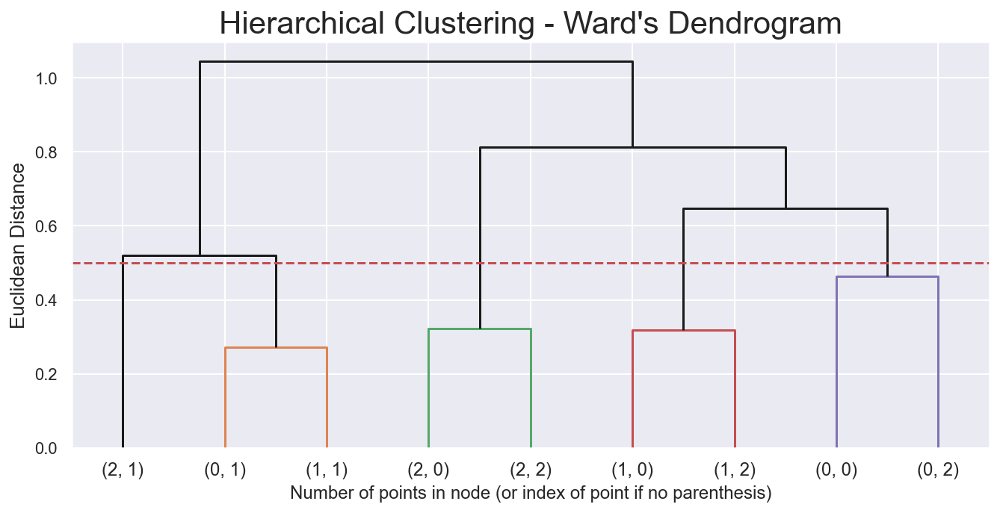

In [85]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py

# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 0.5
dendrogram(linkage_matrix, truncate_mode='level', labels=df_centroids.index, p=5, color_threshold=y_threshold, above_threshold_color='k')
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'Euclidean Distance', fontsize=13)
plt.show()

In [86]:
# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(
    linkage='ward', 
    affinity='euclidean', 
    n_clusters=5
)
hclust_labels = hclust.fit_predict(df_centroids)
df_centroids['hclust_labels'] = hclust_labels

df_centroids  # centroid's cluster labels

MonthSal  CustMonVal  PremMotor  PremHousehold  \
value_labels needs_labels                                                   
0            0             0.264928    0.307679   0.410178       0.148594   
             1             0.329385    0.319437   0.734329       0.079578   
             2             0.183069    0.360624   0.165253       0.334995   
1            0             0.680952    0.307262   0.427214       0.146845   
             1             0.594911    0.317035   0.744160       0.083674   
             2             0.669385    0.357471   0.253562       0.292732   
2            0             0.600351    0.305502   0.436067       0.139434   
             1             0.514533    0.318248   0.751361       0.080749   
             2             0.603259    0.356708   0.273057       0.298623   

                           PremHealth  PremLife  PremWork   CustDur  \
value_labels needs_labels                                             
0            0               0.529144  0.121978  0.140512  0.300052   
             1               0.265963  0.059194  0.072472  0.304601   
             2               0.375282  0.322668  0.332622  0.204779   
1            0               0.505610  0.126803  0.138872  0.263485   
             1               0.245232  0.062981  0.073833  0.253092   
             2               0.395017  0.252721  0.277368  0.271193   
2            0               0.504615  0.122477  0.138156  0.729570   
             1               0.241141  0.059075  0.073325  0.725479   
             2               0.377301  0.256326  0.260150  0.732174   

                           hclust_labels  
value_labels needs_labels                 
0            0                         0  
             1                         3  
             2                         0  
1            0                         1  
             1                         3  
             2                         1  
2            0                         2  
             1                         4  
             2                         2

In [87]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = df_centroids['hclust_labels'].to_dict()

df_ = df_scaled.copy()

# Mapping the hierarchical clusters on the centroids to the observations
df_['merged_labels'] = df_.apply(
    lambda row: cluster_mapper[
        (row['value_labels'], row['needs_labels'])
    ], axis=1
)

# Merged cluster centroids
df_.groupby('merged_labels').mean()[metric_features]

,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,CustDur
merged_labels,,,,,,,,
0,0.228511,0.331232,0.301219,0.231518,0.460696,0.211258,0.225975,0.257668
1,0.678810,0.316561,0.395052,0.173864,0.485127,0.150124,0.164523,0.264912
2,0.600805,0.313501,0.410605,0.164298,0.484729,0.143383,0.157211,0.729977
3,0.466982,0.318192,0.739424,0.081701,0.255220,0.061156,0.073177,0.277909
4,0.514533,0.318248,0.751361,0.080749,0.241141,0.059075,0.073325,0.725479


In [88]:
#Merge cluster contigency table
# Getting size of each final cluster
df_counts = df_.groupby('merged_labels')\
    .size()\
    .to_frame()

# Getting the dem_val and needs labels
df_counts = df_counts\
    .rename({v:k for k, v in cluster_mapper.items()})\
    .reset_index()

df_counts['value_labels'] = df_counts['merged_labels'].apply(lambda x: x[0])
df_counts['needs_labels'] = df_counts['merged_labels'].apply(lambda x: x[1])
df_counts.pivot('value_labels', 'needs_labels', 0)

needs_labels,1,2
value_labels,,
0,NaN,2893.0
1,2252.0,1501.0
2,1880.0,1703.0


In [89]:
# Setting df to have the final product, behavior and merged clusters
df = df_.copy()

In [90]:
df.head()

,MonthSal,CustMonVal,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,CustDur,value_labels,needs_labels,merged_labels
CustID,,,,,,,,,,,
1,0.393345,0.394874,0.644732,0.083372,0.333663,0.145118,0.079112,0.541667,2,1,4
2,0.073379,0.162755,0.138411,0.265148,0.266984,0.541351,0.323484,0.066667,0,2,0
3,0.414676,0.450943,0.356778,0.161669,0.284716,0.250819,0.304014,0.291667,0,2,0
4,0.163396,0.214491,0.316614,0.063885,0.704047,0.113762,0.110466,0.333333,0,0,0
5,0.305034,0.238161,0.581559,0.066287,0.415084,0.069268,0.146366,0.500000,0,0,0


# 4. Cluster Analysis

## 4.2 Cluster visualization 

### 4.2.1 t-SNE

In [91]:
two_dim = TSNE(random_state=42).fit_transform(df[metric_features])

C:\Users\rfdns\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
C:\Users\rfdns\anaconda3\lib\site-packages\sklearn\manifold\_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


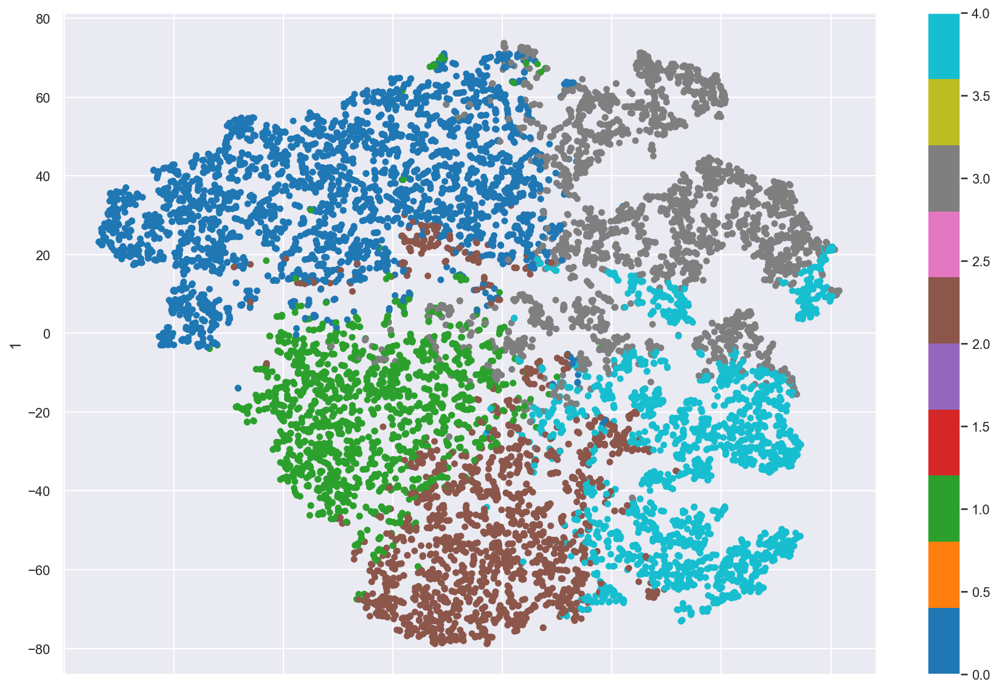

In [92]:
# t-SNE visualization
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=df['merged_labels'], colormap='tab10', figsize=(15,10))
plt.show()

### 4.2.2 UMAP

https://www.kaggle.com/code/parulpandey/part3-visualising-kannada-mnist-with-umap/notebook

https://umap-learn.readthedocs.io/en/latest/parameters.html

In [93]:
# Initialize the UMAP model
model = umap.UMAP(n_neighbors=5, min_dist=0.1, metric='canberra', n_components=2, random_state=42)

In [94]:
# Fit the model to the data and transform it to the low-dimensional space
embedding = model.fit_transform(df[metric_features])

In [95]:
# Create a color map to assign a unique color to each cluster
colormap = np.array(['#1f77b4', '#2ca02c', '#8c564b', '#7f7f7f', '#17becf'])

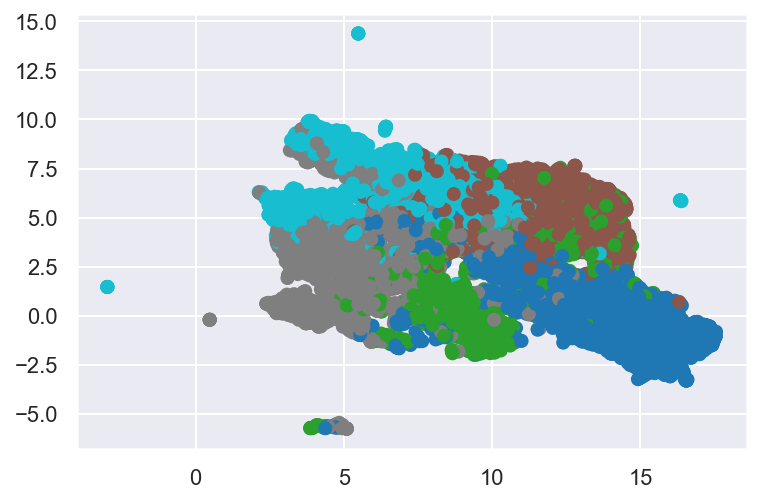

In [96]:
# Plot the data points with color indicating the cluster label
plt.scatter(embedding[:, 0], embedding[:, 1], c=colormap[df['merged_labels']])
plt.show()

## 4.2 Cluster Simple Profiling

In [97]:
def cluster_profiles(df, label_columns, figsize, compar_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    if compar_titles == None:
        compar_titles = [""]*len(label_columns)
        
    sns.set()
    fig, axes = plt.subplots(nrows=len(label_columns), ncols=2, figsize=figsize, squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, label, color=sns.color_palette(), ax=ax[0])
        sns.barplot(x=label, y="counts", data=counts, ax=ax[1])

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=-20)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
    
    plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profilling", fontsize=23)
    plt.show()

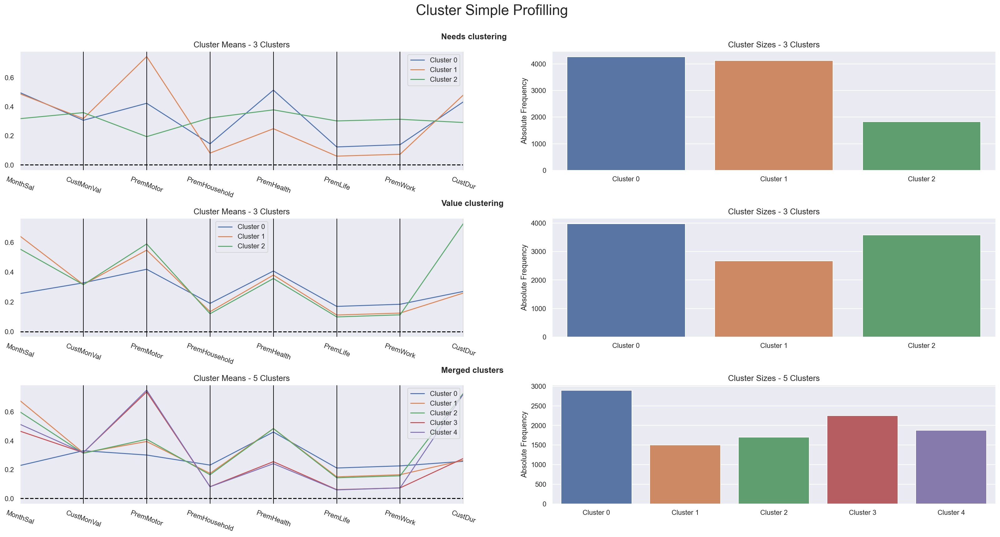

In [98]:
# Profilling each cluster (needs, value, merged)
cluster_profiles(
    df = df[metric_features + ['needs_labels', 'value_labels', 'merged_labels']], 
    label_columns = ['needs_labels', 'value_labels', 'merged_labels'], 
    figsize = (28, 13), 
    compar_titles = ["Needs clustering", "Value clustering", "Merged clusters"]
)

For the 5 clusters:
- There is barely a difference in the CustMonVal between clusters
- Cluster 0 earn way less money than the others, clusters 1 and 2 earn the best salaries
- Clusters 3 and 4 spend a lot more on Motor Insurance and less on the others
- Cluster 0 spend more on household, life and work and less on motor than the others
- Clusters 0, 1 and 2 spend more on Health Insurance
- Clusters 2 and 4 are the oldest customers while clusters 0, 1 and 3 are newer costumers

- Cluster 0: earn way less money than the others (probably younger), spends a bit more on Household, Health, Life and Work insurance, less in motor, new customers
- Cluster 3: spend a lot more on Motor Insurance than other insurance, new customers
- Cluster 4: spend a lot more on Motor Insurance than other insurance, old customers
- Cluster 2: best salaries (probably older people), spend more on health insurance than other clusters, old customers
- Cluster 1: best salaries (probably older people), spend more on health insurance than other clusters,, new customers

## 4.3 Size of the Clusters - Part-to-Whole Mini Pie Charts

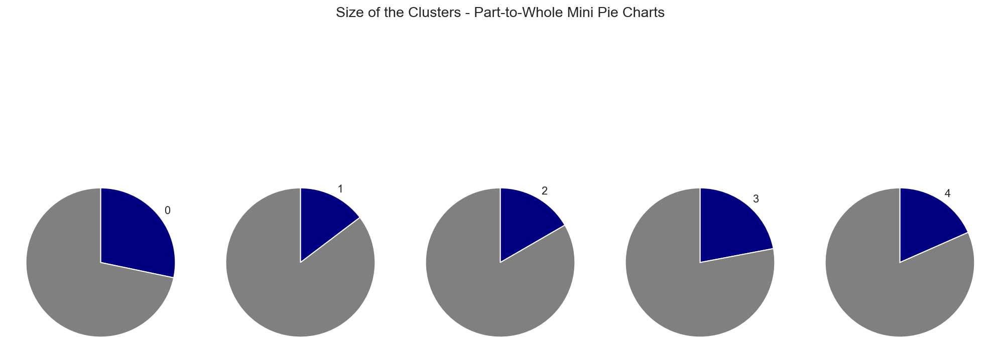

In [111]:
total_values = sum(df_counts[0])
values = [[df_counts[0][0], total_values-df_counts[0][0]], [df_counts[0][1], total_values-df_counts[0][1]], [df_counts[0][2], total_values-df_counts[0][2]], [df_counts[0][3], total_values-df_counts[0][3]], [df_counts[0][4], total_values-df_counts[0][4]]]
labels = [['0', ''], ['1', ''], ['2', ''], ['3', ''], ['4', '']] 

# Create a figure with a grid of subplots
fig, axs = plt.subplots(1, len(values), figsize=(14, 7))

# Plot each pie chart in a separate subplot
for i, ax in enumerate(axs):
    ax.pie(values[i], labels=labels[i], startangle=90, counterclock=False, colors=['navy', 'grey'])

# Add a title
fig.suptitle("Size of the Clusters - Part-to-Whole Mini Pie Charts")

# Display the plot
plt.show()

## 4.4 Comparing Profiles - Radar

https://towardsdatascience.com/how-to-create-and-visualize-complex-radar-charts-f7764d0f3652

In [100]:
result = df_.groupby('merged_labels').mean()[metric_features]
categories = result.columns
fig = go.Figure()

for g in result.index:
    fig.add_trace(go.Scatterpolar(
        r = result.loc[g].values,
        theta = categories,
        name = f'cluster #{g}'
    ))

fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0, 0.8] # here we can define the range
    )),
  showlegend=True,
    title="Comparing Profiles",
    title_x=0.5
)

fig.show()

## 4.5 Profiling (comparing boxplots between clusters and dataset)

https://www.tutorialspoint.com/plot-multiple-boxplots-in-one-graph-in-pandas-or-matplotlib

### 4.5.1 MonthSal

In [101]:
df_MonthSal = df[['MonthSal'] + ['merged_labels']]
MonthSal_0 = df_MonthSal.loc[df_MonthSal['merged_labels'] == 0, 'MonthSal']
MonthSal_1 = df_MonthSal.loc[df_MonthSal['merged_labels'] == 1, 'MonthSal']
MonthSal_2 = df_MonthSal.loc[df_MonthSal['merged_labels'] == 2, 'MonthSal']
MonthSal_3 = df_MonthSal.loc[df_MonthSal['merged_labels'] == 3, 'MonthSal']
MonthSal_4 = df_MonthSal.loc[df_MonthSal['merged_labels'] == 4, 'MonthSal']
MonthSal_total = df_scaled['MonthSal']

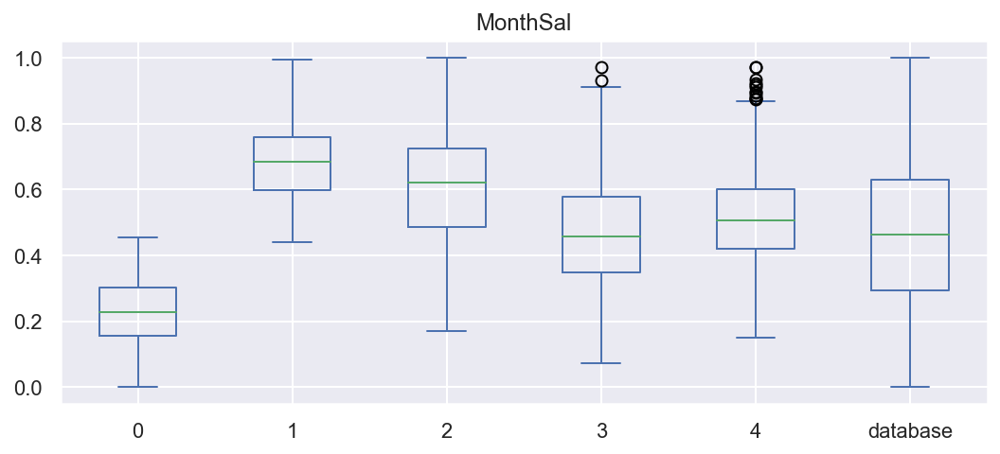

In [102]:
# Set the figure size
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

# Pandas dataframe
data = pd.DataFrame({"0": MonthSal_0, "1": MonthSal_1, "2": MonthSal_2, "3": MonthSal_3, "4": MonthSal_4, "database": MonthSal_total})

# Plot the dataframe
ax = data[['0', '1', '2', '3', '4', 'database']].plot(kind='box', title='MonthSal')

# Display the plot
plt.show()

### 4.5.2 CustDur

In [103]:
df_CustDur = df[['CustDur'] + ['merged_labels']]
CustDur_0 = df_CustDur.loc[df_CustDur['merged_labels'] == 0, 'CustDur']
CustDur_1 = df_CustDur.loc[df_CustDur['merged_labels'] == 1, 'CustDur']
CustDur_2 = df_CustDur.loc[df_CustDur['merged_labels'] == 2, 'CustDur']
CustDur_3 = df_CustDur.loc[df_CustDur['merged_labels'] == 3, 'CustDur']
CustDur_4 = df_CustDur.loc[df_CustDur['merged_labels'] == 4, 'CustDur']
CustDur_total = df_scaled['CustDur']

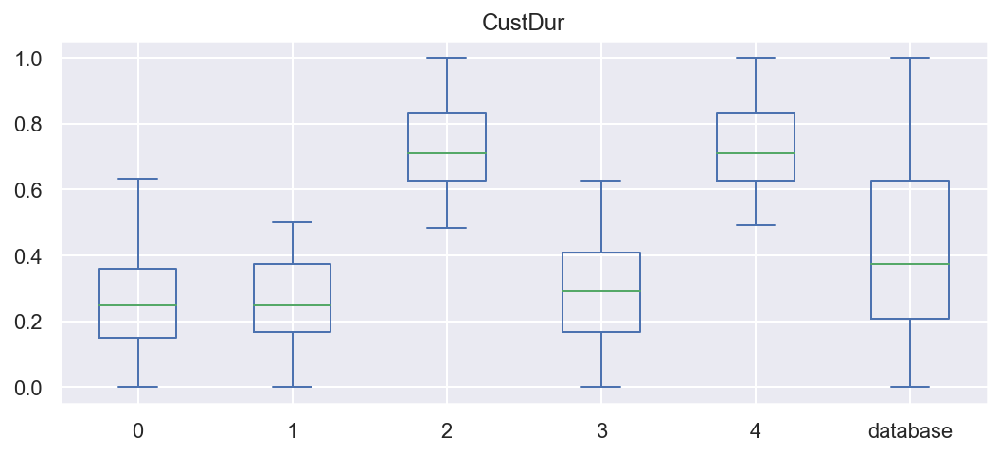

In [104]:
# Set the figure size
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

# Pandas dataframe
data = pd.DataFrame({"0": CustDur_0, "1": CustDur_1, "2": CustDur_2, "3": CustDur_3, "4": CustDur_4, "database": CustDur_total})

# Plot the dataframe
ax = data[['0', '1', '2', '3', '4', 'database']].plot(kind='box', title='CustDur')

# Display the plot
plt.show()

### 4.5.3 CustMonVal

In [105]:
df_CustMonVal = df[['CustMonVal'] + ['merged_labels']]
CustMonVal_0 = df_CustMonVal.loc[df_CustMonVal['merged_labels'] == 0, 'CustMonVal']
CustMonVal_1 = df_CustMonVal.loc[df_CustMonVal['merged_labels'] == 1, 'CustMonVal']
CustMonVal_2 = df_CustMonVal.loc[df_CustMonVal['merged_labels'] == 2, 'CustMonVal']
CustMonVal_3 = df_CustMonVal.loc[df_CustMonVal['merged_labels'] == 3, 'CustMonVal']
CustMonVal_4 = df_CustMonVal.loc[df_CustMonVal['merged_labels'] == 4, 'CustMonVal']
CustMonVal_total = df_scaled['CustMonVal']

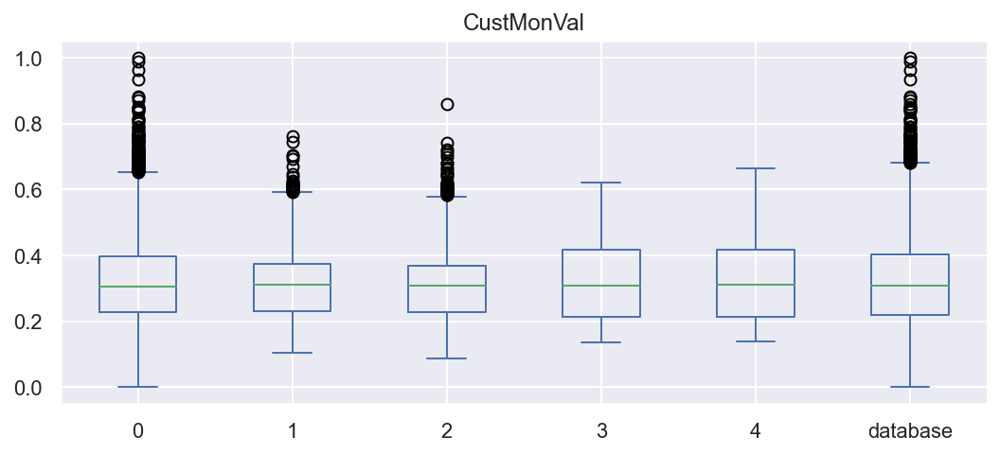

In [106]:
# Set the figure size
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

# Pandas dataframe
data = pd.DataFrame({"0": CustMonVal_0, "1": CustMonVal_1, "2": CustMonVal_2, "3": CustMonVal_3, "4": CustMonVal_4, "database": CustMonVal_total})

# Plot the dataframe
ax = data[['0', '1', '2', '3', '4', 'database']].plot(kind='box', title='CustMonVal')

# Display the plot
plt.show()

### 4.5.4 PremMotor

In [107]:
df_PremMotor = df[['PremMotor'] + ['merged_labels']]
PremMotor_0 = df_PremMotor.loc[df_PremMotor['merged_labels'] == 0, 'PremMotor']
PremMotor_1 = df_PremMotor.loc[df_PremMotor['merged_labels'] == 1, 'PremMotor']
PremMotor_2 = df_PremMotor.loc[df_PremMotor['merged_labels'] == 2, 'PremMotor']
PremMotor_3 = df_PremMotor.loc[df_PremMotor['merged_labels'] == 3, 'PremMotor']
PremMotor_4 = df_PremMotor.loc[df_PremMotor['merged_labels'] == 4, 'PremMotor']
PremMotor_total = df_scaled['PremMotor']

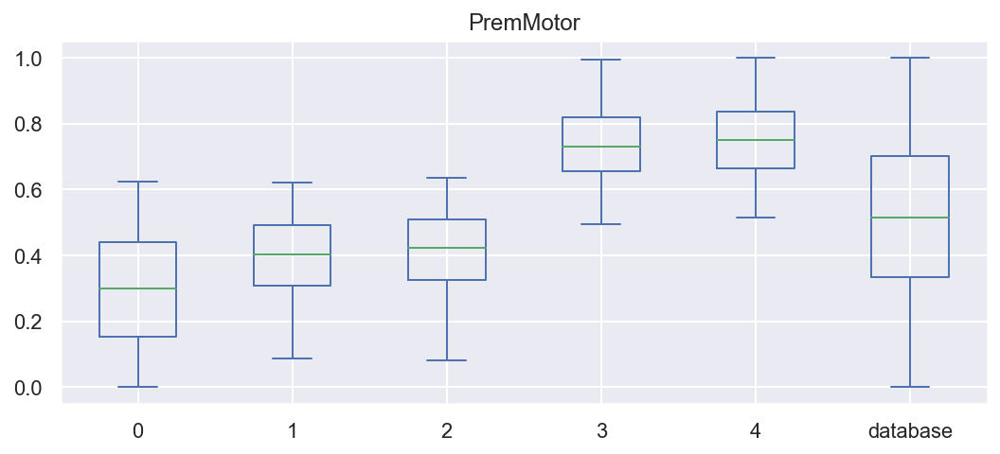

In [108]:
# Set the figure size
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

# Pandas dataframe
data = pd.DataFrame({"0": PremMotor_0, "1": PremMotor_1, "2": PremMotor_2, "3": PremMotor_3, "4": PremMotor_4, "database": PremMotor_total})

# Plot the dataframe
ax = data[['0', '1', '2', '3', '4', 'database']].plot(kind='box', title='PremMotor')

# Display the plot
plt.show()

### 4.5.5 PremHousehold

In [109]:
df_PremHousehold = df[['PremHousehold'] + ['merged_labels']]
PremHousehold_0 = df_PremHousehold.loc[df_PremHousehold['merged_labels'] == 0, 'PremHousehold']
PremHousehold_1 = df_PremHousehold.loc[df_PremHousehold['merged_labels'] == 1, 'PremHousehold']
PremHousehold_2 = df_PremHousehold.loc[df_PremHousehold['merged_labels'] == 2, 'PremHousehold']
PremHousehold_3 = df_PremHousehold.loc[df_PremHousehold['merged_labels'] == 3, 'PremHousehold']
PremHousehold_4 = df_PremHousehold.loc[df_PremHousehold['merged_labels'] == 4, 'PremHousehold']
PremHousehold_total = df_scaled['PremHousehold']

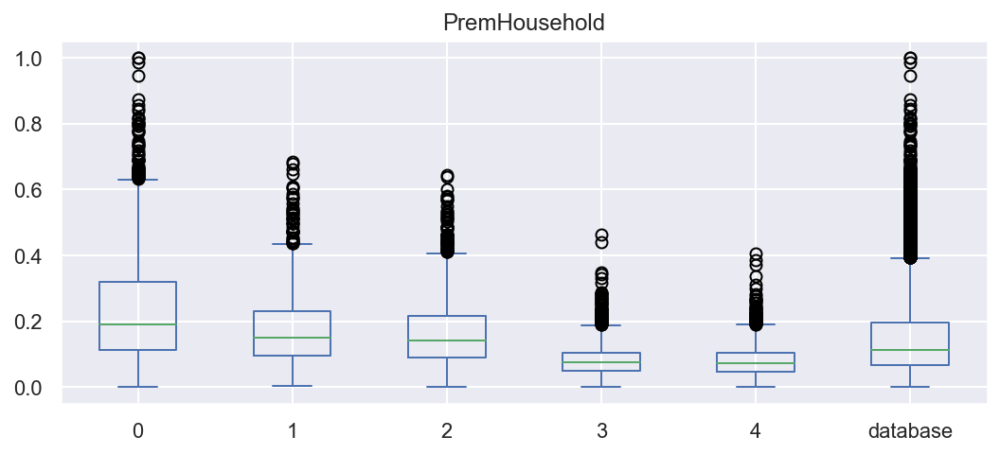

In [110]:
# Set the figure size
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

# Pandas dataframe
data = pd.DataFrame({"0": PremHousehold_0, "1": PremHousehold_1, "2": PremHousehold_2, "3": PremHousehold_3, "4": PremHousehold_4, "database": PremHousehold_total})

# Plot the dataframe
ax = data[['0', '1', '2', '3', '4', 'database']].plot(kind='box', title='PremHousehold')

# Display the plot
plt.show()

### 4.5.6 PremHealth

In [112]:
df_PremHealth = df[['PremHealth'] + ['merged_labels']]
PremHealth_0 = df_PremHealth.loc[df_PremHealth['merged_labels'] == 0, 'PremHealth']
PremHealth_1 = df_PremHealth.loc[df_PremHealth['merged_labels'] == 1, 'PremHealth']
PremHealth_2 = df_PremHealth.loc[df_PremHealth['merged_labels'] == 2, 'PremHealth']
PremHealth_3 = df_PremHealth.loc[df_PremHealth['merged_labels'] == 3, 'PremHealth']
PremHealth_4 = df_PremHealth.loc[df_PremHealth['merged_labels'] == 4, 'PremHealth']
PremHealth_total = df_scaled['PremHealth']

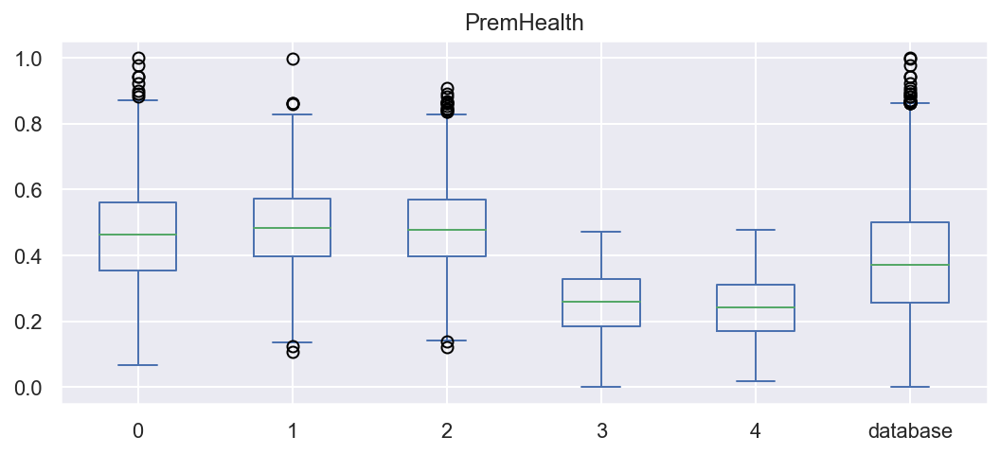

In [113]:
# Set the figure size
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

# Pandas dataframe
data = pd.DataFrame({"0": PremHealth_0, "1": PremHealth_1, "2": PremHealth_2, "3": PremHealth_3, "4": PremHealth_4, "database": PremHealth_total})

# Plot the dataframe
ax = data[['0', '1', '2', '3', '4', 'database']].plot(kind='box', title='PremHealth')

# Display the plot
plt.show()

### 4.5.7 PremLife

In [114]:
df_PremLife = df[['PremLife'] + ['merged_labels']]
PremLife_0 = df_PremLife.loc[df_PremLife['merged_labels'] == 0, 'PremLife']
PremLife_1 = df_PremLife.loc[df_PremLife['merged_labels'] == 1, 'PremLife']
PremLife_2 = df_PremLife.loc[df_PremLife['merged_labels'] == 2, 'PremLife']
PremLife_3 = df_PremLife.loc[df_PremLife['merged_labels'] == 3, 'PremLife']
PremLife_4 = df_PremLife.loc[df_PremLife['merged_labels'] == 4, 'PremLife']
PremLife_total = df_scaled['PremLife']

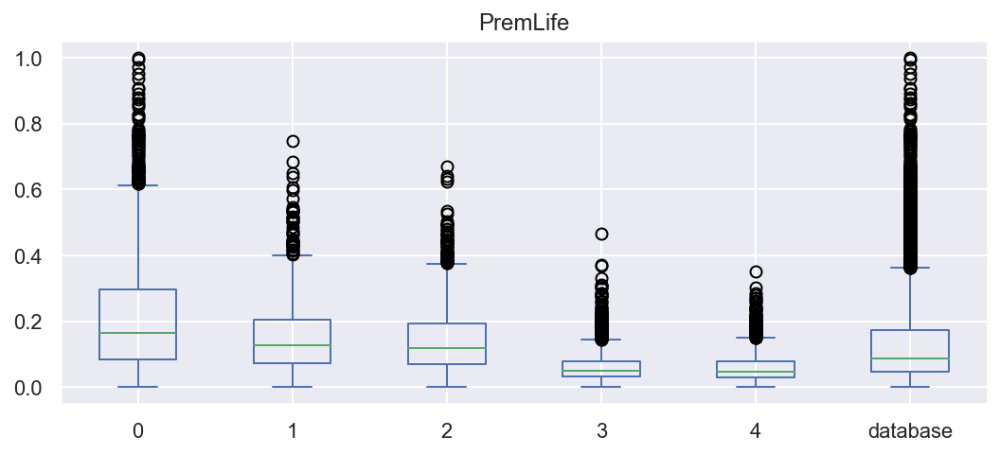

In [115]:
# Set the figure size
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

# Pandas dataframe
data = pd.DataFrame({"0": PremLife_0, "1": PremLife_1, "2": PremLife_2, "3": PremLife_3, "4": PremLife_4, "database": PremLife_total})

# Plot the dataframe
ax = data[['0', '1', '2', '3', '4', 'database']].plot(kind='box', title='PremLife')

# Display the plot
plt.show()

### 4.5.8 PremWork

In [116]:
df_PremWork = df[['PremWork'] + ['merged_labels']]
PremWork_0 = df_PremWork.loc[df_PremWork['merged_labels'] == 0, 'PremWork']
PremWork_1 = df_PremWork.loc[df_PremWork['merged_labels'] == 1, 'PremWork']
PremWork_2 = df_PremWork.loc[df_PremWork['merged_labels'] == 2, 'PremWork']
PremWork_3 = df_PremWork.loc[df_PremWork['merged_labels'] == 3, 'PremWork']
PremWork_4 = df_PremWork.loc[df_PremWork['merged_labels'] == 4, 'PremWork']
PremWork_total = df_scaled['PremWork']

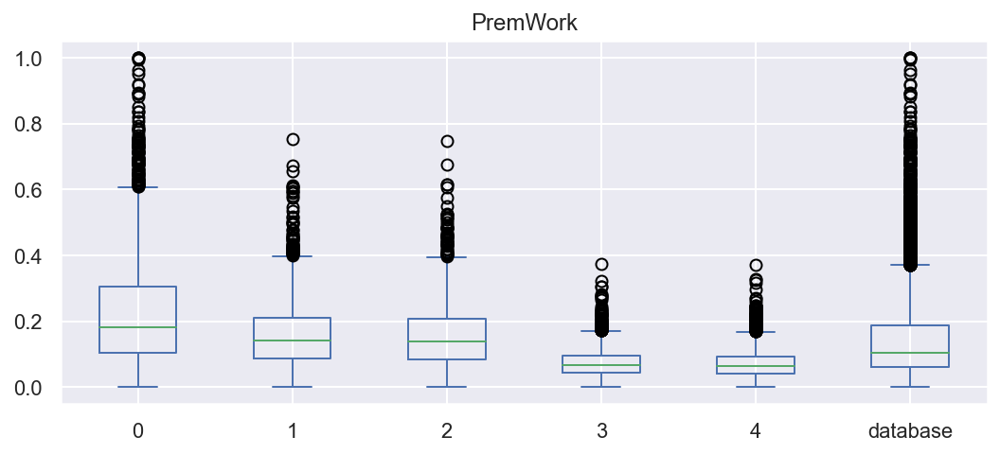

In [117]:
# Set the figure size
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

# Pandas dataframe
data = pd.DataFrame({"0": PremWork_0, "1": PremWork_1, "2": PremWork_2, "3": PremWork_3, "4": PremWork_4, "database": PremWork_total})

# Plot the dataframe
ax = data[['0', '1', '2', '3', '4', 'database']].plot(kind='box', title='PremWork')

# Display the plot
plt.show()

## 4.6 Density of categrical variables for every cluster 

### 4.6.1 Children

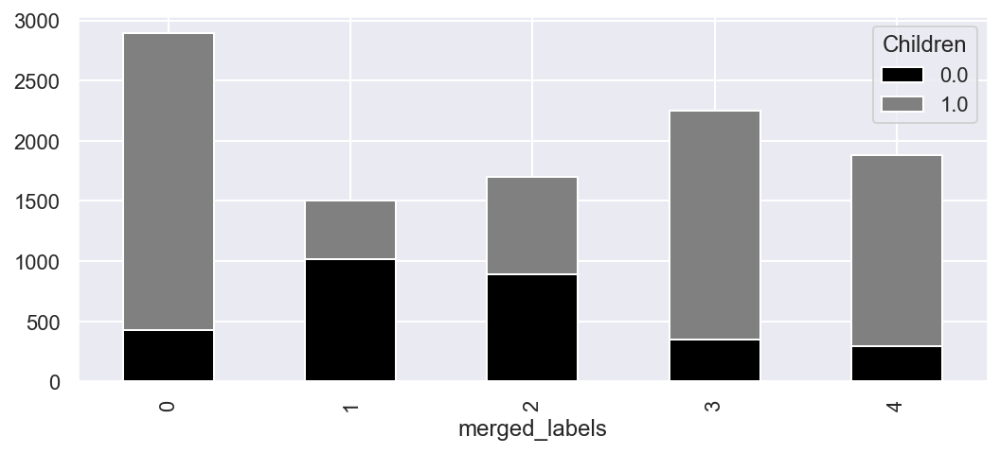

In [118]:
df_children = pd.merge(df_preprocessed['Children'], df['merged_labels'], left_index=True, right_index=True)
df_children_plot = df_children.groupby(['merged_labels', 'Children']).size().unstack()

# Plot the data
df_children_plot.plot(kind='bar', stacked=True, color=['black', 'grey'])

# Show the plot
plt.show()

### 4.6.2 GeoLivArea

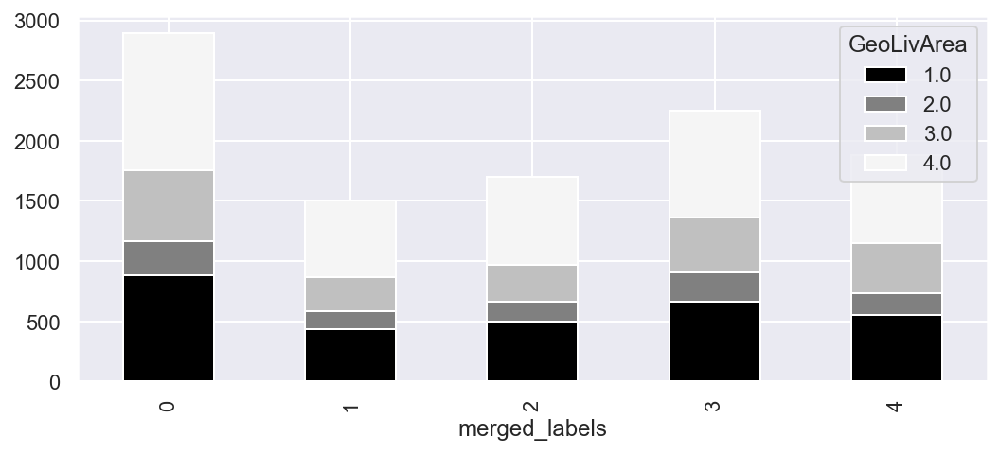

In [119]:
df_GeoLivArea = pd.merge(df_preprocessed['GeoLivArea'], df['merged_labels'], left_index=True, right_index=True)
df_GeoLivArea_plot = df_GeoLivArea.groupby(['merged_labels', 'GeoLivArea']).size().unstack()

# Plot the data
df_GeoLivArea_plot.plot(kind='bar', stacked=True, color=['black', 'grey', 'silver', 'whitesmoke'])

# Show the plot
plt.show()

### 4.6.3 EduDeg

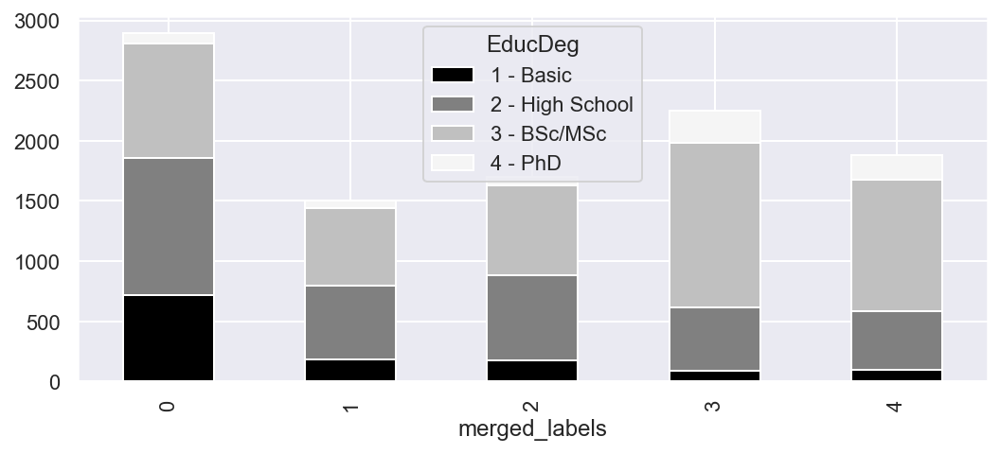

In [120]:
df_EducDeg = pd.merge(df_preprocessed['EducDeg'], df['merged_labels'], left_index=True, right_index=True)
df_EducDeg_plot = df_EducDeg.groupby(['merged_labels', 'EducDeg']).size().unstack()

# Plot the data
df_EducDeg_plot.plot(kind='bar', stacked=True, color=['black', 'grey', 'silver', 'whitesmoke'])

# Show the plot
plt.show()

# 5. Assess feature importance 

## 5.1 Using the R²

What proportion of each variables total SS is explained between clusters?

In [121]:
def get_ss_variables(df):
    """Get the SS for each variable
    """
    ss_vars = df.var() * (df.count() - 1)
    return ss_vars

def r2_variables(df, labels):
    """Get the R² for each variable
    """
    sst_vars = get_ss_variables(df)
    ssw_vars = np.sum(df.groupby(labels).apply(get_ss_variables))
    return 1 - ssw_vars/sst_vars

In [122]:
# We are essentially decomposing the R² into the R² for each variable
r2_variables(df[metric_features + ['merged_labels']], 'merged_labels').drop('merged_labels').sort_values()

CustMonVal       0.003342
PremLife         0.247334
PremHousehold    0.250053
PremWork         0.254394
PremHealth       0.442594
MonthSal         0.592577
PremMotor        0.700124
CustDur          0.715626
dtype: float64

CustDur, PremMotor, MonthSal and PremHealth are the variables that are more important to distinguish the clusters 

## 5.2 Using a Decision Tree

In [123]:
#  Reversing data to original scale for better interpretation of the DT
df[metric_features] = scaler.inverse_transform(df[metric_features])

We get the normalized total reduction of the criterion (gini or entropy) brought by that feature (also known as Gini importance).

In [124]:
# Preparing the data
X = df.drop(columns=['needs_labels','value_labels','merged_labels'])
y = df.merged_labels

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=42, max_depth=3)
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 94.43% of the customers correctly


In [125]:
# Assessing feature importance
pd.Series(dt.feature_importances_, index=X_train.columns).sort_values()

CustMonVal       0.000000
PremHousehold    0.000000
PremLife         0.000000
PremWork         0.000000
PremHealth       0.021950
MonthSal         0.251886
PremMotor        0.261859
CustDur          0.464304
dtype: float64

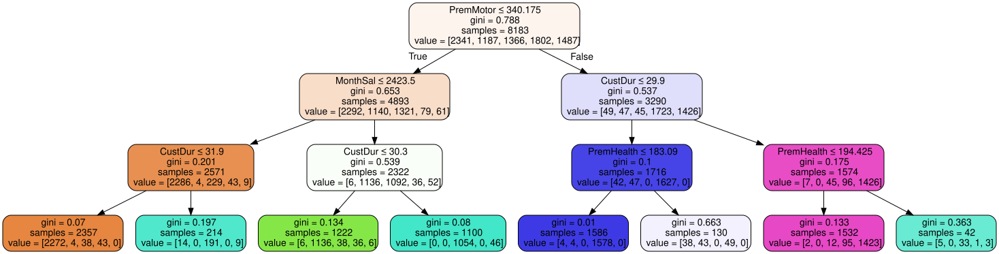

In [126]:
# Visualizing the decision tree
dot_data = export_graphviz(dt, out_file=None, 
                           feature_names=X.columns.to_list(),
                           filled=True,
                           rounded=True,
                           special_characters=True)  
graphviz.Source(dot_data)

# 6. Reclassifying Outliers

In [127]:
# Predicting the cluster labels of the outliers
df_out['merged_labels'] = dt.predict(df_out[metric_features])

In [128]:
df_out

,EducDeg,MonthSal,GeoLivArea,Children,CustMonVal,ClaimsRate,PremMotor,PremHousehold,PremHealth,PremLife,PremWork,Age,CustDur,outlier,merged_labels
CustID,,,,,,,,,,,,,,,
146,1 - Basic,2554.0,1.0,1.0,-96.11,1.12,144.36,-11.10,381.85,47.23,12.78,30.0,34.2,-1,2
282,3 - BSc/MSc,3083.0,1.0,1.0,-175.00,1.30,506.43,-75.00,55.90,5.89,1.78,54.0,39.0,-1,4
288,2 - High School,2193.0,3.0,1.0,618.80,0.00,139.58,82.25,246.49,72.57,102.91,41.0,28.0,-1,0
502,2 - High School,2483.0,1.0,1.0,625.68,0.00,160.03,73.35,129.69,116.91,170.70,48.0,38.0,-1,2
575,1 - Basic,3110.0,4.0,1.0,-233.26,1.26,116.02,255.60,163.81,60.79,208.26,59.0,29.0,-1,1
818,4 - PhD,1541.0,4.0,1.0,640.57,0.00,329.73,83.35,222.93,6.89,22.67,24.0,25.4,-1,0
831,2 - High School,2126.4,4.0,0.0,475.43,0.00,274.83,0.00,180.59,25.45,19.56,74.0,28.0,-1,0
1070,1 - Basic,566.0,4.0,1.0,-71.01,1.02,14.56,1777.55,49.23,46.01,121.69,18.0,20.4,-1,0
1076,2 - High School,3106.0,1.0,1.0,-262.04,1.41,273.05,-25.00,114.91,124.69,87.35,67.0,23.0,-1,1


# Extra: calculating the age and salary median-mean for each cluster

This is done at the end of the notebook as here we have the real scale of the data

In [129]:
df_age = pd.merge(df_preprocessed['Age'], df['merged_labels'], left_index=True, right_index=True)
df_age_range = df_age.groupby('merged_labels').median()['Age']
df_age_range

merged_labels
0    27.0
1    68.0
2    63.0
3    48.0
4    51.0
Name: Age, dtype: float64

In [130]:
df_age = pd.merge(df_preprocessed['Age'], df['merged_labels'], left_index=True, right_index=True)
df_age_range = df_age.groupby('merged_labels').mean()['Age']
df_age_range

merged_labels
0    27.832561
1    65.991206
2    59.892543
3    48.656217
4    52.494468
Name: Age, dtype: float64

In [131]:
df_MonthSal_range = df.groupby('merged_labels').median()['MonthSal']
df_MonthSal_range

merged_labels
0    1396.0
1    3538.0
2    3240.0
3    2471.5
4    2698.5
Name: MonthSal, dtype: float64

In [132]:
df_MonthSal_range = df.groupby('merged_labels').mean()['MonthSal']
df_MonthSal_range

merged_labels
0    1404.261735
1    3515.259560
2    3149.574516
3    2522.211989
4    2745.131596
Name: MonthSal, dtype: float64